# FINANCE AND RISK ANALYTICS


## Problem Statement

In the recent past, the industry of wealth management has seen a lot of growth. Every individual or business actively searches for opportunities to get the maximum returns. However, in most of the cases, they either lack the skills to identify the right investment opportunity, or there is a shortage of time for finding these opportunities. Hence, this gave rise to the dedicated individuals who perform this task on behalf of the investors for a commission - Portfolio managers.

A portfolio manager makes investment decisions and carries out other related activities on behalf of vested investors. They work with a team of analysts and researchers, and their main objective is to realise the needs of the investor and suggest a suitable portfolio that meets all the expectations. They are responsible for establishing the best investment strategy, selecting appropriate investments along with the right allocation. However, in doing so, they face a lot of competition in the form of other portfolio managers and rival firms. Therefore, the portfolio manager has to use the available resources to provide the best solution to the investor.

Consider yourself working for an associate at an investment firm that manages accounts for private clients. Your role requires you to analyse a portfolio of stocks to provide consultation on investment management based on client’s requirement

Your task is to provide consultation to two different investors, Mr Patrick Jyenger and Mr Peter Jyenger based on their requirements and financial objectives. You can refer to the elements mentioned in the video to develop the investor persona. The image below summarises the profile of the two investors:


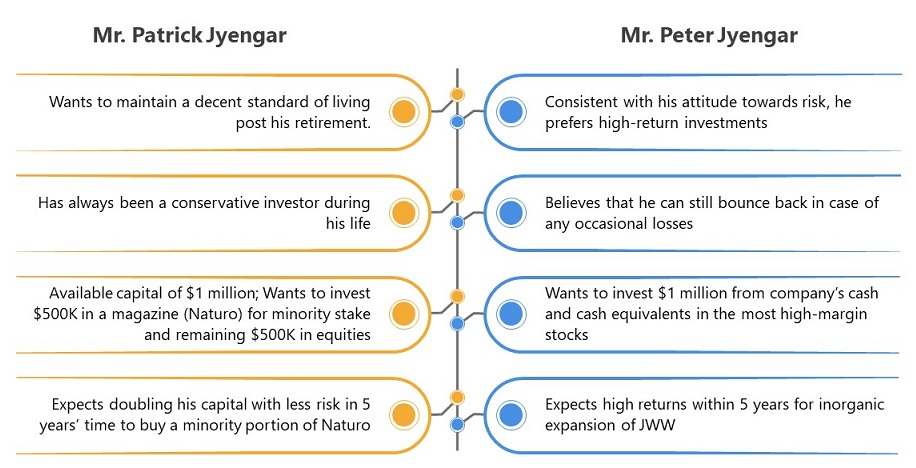

## Objective 

To Suggest a Portfolio of stocks to Mr Patrick Jyenger based on his risk profile to meet his goal on doubling the amount of 500K Dollars in five years that would help him buy a minoruty stake in Naturo.

To provide a High risk and High Returns stock to Mr Peter Jyenger based on his risk profile to get high returns for the 1 Million Dollars invested amount of within five years that would help him for the inorganic expansion of JWW.

## Importing Libraries 

In [1]:
import numpy as np 
import pandas as pd
import math
import datetime as dt

# packages for data visualisation
import matplotlib as plt 
import matplotlib.pyplot as plt
import matplotlib.style as style
import seaborn as sns
%matplotlib inline
# sns.set_theme()
import warnings 
warnings.filterwarnings("ignore") 

pd.set_option('display.max_columns', None)

# import plotly libraries for data visualization
import plotly as py
import plotly.graph_objs as go
from plotly.offline import iplot, init_notebook_mode

# package for scaling and normalizing data
from sklearn.preprocessing import MinMaxScaler

In [2]:
data_info = pd.read_csv("Annexure-I.csv")
data_info

,Ticker,Industry,Company Name
0,AAL,Aviation,American Airlines Group Inc
1,ALGT,Aviation,Allegiant Travel Company
2,ALK,Aviation,Alaska Air Group Inc
3,DAL,Aviation,Delta Air Lines Inc
4,HA,Aviation,Hawaiian Holdings Inc
5,LUV,Aviation,Southwest Airlines Co
6,BCS,Finance,Barclays
7,CS,Finance,Credit Suisse
8,DB,Finance,Deutsche Bank
9,GS,Finance,Goldman Sachs


### Importing Aviation Dataset

In [3]:
AAL = pd.read_csv("AAL.csv")
ALGT = pd.read_csv("ALGT.csv")
ALK = pd.read_csv("ALK.csv")
DAL = pd.read_csv("DAL.csv")
HA = pd.read_csv("HA.csv")
LUV = pd.read_csv("LUV.csv")

### Importing Finance Dataset

In [4]:
BCS = pd.read_csv('BCS.csv')
CS = pd.read_csv('CS.csv')
DB = pd.read_csv('DB.csv')
GS = pd.read_csv('GS.csv')
MS = pd.read_csv('MS.csv')
WFC = pd.read_csv('WFC.csv')

### Importing the Healthcare Datasets

In [5]:
BHC = pd.read_csv('BHC.csv')
JNJ = pd.read_csv('JNJ.csv')
MRK = pd.read_csv('MRK.csv')
PFE = pd.read_csv('PFE.csv')
RHHBY = pd.read_csv('RHHBY.csv')
UNH = pd.read_csv('UNH.csv')

### Importing the Technology Datasets

In [6]:
AAPL = pd.read_csv('AAPL.csv')
AMZN = pd.read_csv('AMZN.csv')
FB = pd.read_csv('FB.csv')
GOOG = pd.read_csv('GOOG.csv')
IBM = pd.read_csv('IBM.csv')
MSFT = pd.read_csv('MSFT.csv')

### Importing SP500 Dataset

In [7]:
SP500 = pd.read_csv('S&P500.csv')

## Reading the Datasets

### Aviation

In [8]:
AAL.head()

,Date,Open,High,Low,Close,Adj Close,Volume
0,01-10-2010,9.29,9.39,9.21,9.29,8.758067,3603800
1,04-10-2010,9.24,9.48,9.05,9.12,8.597802,3856800
2,05-10-2010,9.27,9.35,9.15,9.23,8.701504,3896600
3,06-10-2010,9.27,9.40,9.15,9.23,8.701504,3230200
4,07-10-2010,9.30,9.31,9.07,9.24,8.710930,3877700


In [9]:
ALGT.head()

,Date,Open,High,Low,Close,Adj Close,Volume
0,01-10-2010,42.779999,43.259998,41.869999,43.230000,36.766212,159100.0
1,04-10-2010,43.250000,43.330002,41.310001,41.590000,35.371429,189700.0
2,05-10-2010,41.779999,42.130001,41.299999,42.099998,35.805168,175000.0
3,06-10-2010,42.080002,42.349998,41.349998,41.950001,35.677608,187200.0
4,07-10-2010,42.259998,42.270000,41.500000,41.700001,35.464993,162700.0


In [10]:
ALK.head()

,Date,Open,High,Low,Close,Adj Close,Volume
0,01-10-2010,12.9325,12.9625,12.3675,12.4475,10.972344,1663600.0
1,04-10-2010,12.4300,12.5900,11.9975,12.1425,10.703489,1512400.0
2,05-10-2010,12.2600,12.2850,11.9450,12.2150,10.767396,2567200.0
3,06-10-2010,12.2200,12.3950,12.0875,12.1875,10.743157,1043600.0
4,07-10-2010,12.2775,12.3450,11.2150,11.6250,10.247319,7682400.0


In [11]:
DAL.head()

,Date,Open,High,Low,Close,Adj Close,Volume
0,01-10-2010,11.75,12.01,11.71,12.01,10.668407,9094900.0
1,04-10-2010,11.70,12.01,11.45,11.51,10.224259,7916400.0
2,05-10-2010,11.57,11.87,11.45,11.83,10.508514,12624100.0
3,06-10-2010,11.87,12.05,11.56,11.78,10.464101,10124100.0
4,07-10-2010,11.80,11.82,11.61,11.77,10.455217,7162500.0


In [12]:
HA.head()

,Date,Open,High,Low,Close,Adj Close,Volume
0,01-10-2010,6.02,6.05,5.88,5.96,5.742526,645400.0
1,04-10-2010,5.96,6.00,5.73,5.75,5.540189,618900.0
2,05-10-2010,5.82,5.93,5.77,5.85,5.636539,534800.0
3,06-10-2010,5.85,6.05,5.85,5.97,5.752162,2563900.0
4,07-10-2010,6.04,6.32,5.98,6.15,5.925593,1115200.0


In [13]:
LUV.head()

,Date,Open,High,Low,Close,Adj Close,Volume
0,01-10-2010,13.23,13.24,12.92,12.94,12.018754,5722500.0
1,04-10-2010,12.92,13.09,12.62,12.82,11.907295,6537700.0
2,05-10-2010,12.97,13.16,12.94,13.02,12.093060,8060000.0
3,06-10-2010,12.96,13.10,12.72,12.94,12.018754,7457000.0
4,07-10-2010,12.98,13.03,12.85,12.88,11.963027,3413900.0


### Finance Data

In [14]:
BCS.head()

,Date,Open,High,Low,Close,Adj Close,Volume
0,04-01-2010,16.709677,16.930876,16.663595,16.894009,12.665321,2144300.0
1,05-01-2010,17.631336,17.852535,17.520737,17.824884,13.363193,2710600.0
2,06-01-2010,17.797235,18.202765,17.695852,18.129032,13.591214,2124100.0
3,07-01-2010,18.617512,18.884792,18.506912,18.801844,14.095612,3932100.0
4,08-01-2010,18.986176,19.124424,18.755760,18.967741,14.219986,3055200.0


In [15]:
CS.head()

,Date,Open,High,Low,Close,Adj Close,Volume
0,04-01-2010,49.902344,51.035156,49.765625,50.771484,34.852165,734200.0
1,05-01-2010,51.250000,51.318359,50.644531,51.191406,35.140423,447700.0
2,06-01-2010,50.224609,50.917969,49.951172,50.478516,34.651054,751200.0
3,07-01-2010,51.250000,52.646484,51.201172,52.519531,36.052116,833700.0
4,08-01-2010,52.548828,53.339844,52.441406,53.291016,36.581703,706900.0


In [16]:
DB.head()

,Date,Open,High,Low,Close,Adj Close,Volume
0,04-01-2010,69.103050,70.162216,68.893127,69.875954,59.037861,469500.0
1,05-01-2010,71.412216,71.698471,70.610687,71.211830,60.166534,503300.0
2,06-01-2010,69.847328,70.543892,69.494278,69.980919,59.126545,495000.0
3,07-01-2010,70.133591,70.896950,69.809158,70.772903,59.795689,700100.0
4,08-01-2010,72.891220,73.416031,72.509544,73.330154,61.956295,763900.0


In [17]:
GS.head()

,Date,Open,High,Low,Close,Adj Close,Volume
0,04-01-2010,170.050003,174.250000,169.509995,173.080002,147.920776,9135000.0
1,05-01-2010,173.000000,176.259995,172.570007,176.139999,150.535919,11659400.0
2,06-01-2010,175.380005,175.380005,173.759995,174.259995,148.929138,7381100.0
3,07-01-2010,174.320007,178.750000,173.949997,177.669998,151.843475,8727400.0
4,08-01-2010,176.330002,177.429993,173.949997,174.309998,148.971909,7268100.0


In [18]:
MS.head()

,Date,Open,High,Low,Close,Adj Close,Volume
0,04-01-2010,30.700001,31.969999,30.629999,30.910000,25.759523,20371000.0
1,05-01-2010,31.010000,32.130001,30.930000,32.040001,26.701244,22523400.0
2,06-01-2010,31.969999,32.590000,31.790001,32.450001,27.042919,17028500.0
3,07-01-2010,32.459999,33.270000,32.270000,32.919998,27.434603,18693000.0
4,08-01-2010,32.599998,32.820000,31.980000,32.250000,26.876251,15993400.0


In [19]:
WFC.head()

,Date,Open,High,Low,Close,Adj Close,Volume
0,04-01-2010,27.020000,27.48,26.820000,27.320000,20.318752,39335700.0
1,05-01-2010,27.270000,28.24,27.240000,28.070000,20.876556,55416000.0
2,06-01-2010,28.030001,28.33,27.790001,28.110001,20.906300,33237000.0
3,07-01-2010,28.120001,29.43,27.920000,29.129999,21.664902,61649000.0
4,08-01-2010,28.900000,29.35,28.600000,28.860001,21.464094,35508700.0


### Healthcare and Pharma Data

In [20]:
BHC.head()

,Date,Open,High,Low,Close,Adj Close,Volume
0,01-10-2010,25.120001,25.879999,25.100000,25.750000,24.757708,5778700.0
1,04-10-2010,25.750000,25.990000,25.590000,25.870001,24.873083,4187200.0
2,05-10-2010,26.040001,26.330000,25.830000,26.299999,25.286512,4610300.0
3,06-10-2010,26.150000,26.879999,26.049999,26.690001,25.661484,4448900.0
4,07-10-2010,26.700001,26.910000,26.440001,26.600000,25.574951,2453900.0


In [21]:
JNJ.head()

,Date,Open,High,Low,Close,Adj Close,Volume
0,01-10-2010,62.090000,62.250000,61.570000,61.750000,45.970119,9773200.0
1,04-10-2010,61.540001,61.980000,61.299999,61.669998,45.910553,8703600.0
2,05-10-2010,62.080002,62.939999,62.009998,62.799999,46.751797,12439400.0
3,06-10-2010,62.889999,63.259998,62.500000,63.209999,47.057022,11339800.0
4,07-10-2010,63.290001,63.500000,63.000000,63.220001,47.064480,9826600.0


In [22]:
MRK.head()

,Date,Open,High,Low,Close,Adj Close,Volume
0,01-10-2010,36.759998,36.840000,36.349998,36.599998,26.052284,11741900.0
1,04-10-2010,36.490002,36.750000,36.290001,36.520000,25.995331,9234900.0
2,05-10-2010,36.860001,37.150002,36.700001,37.020000,26.351234,10669200.0
3,06-10-2010,37.040001,37.220001,36.820000,37.009998,26.344130,7541300.0
4,07-10-2010,37.349998,37.389999,36.630001,36.709999,26.130579,13897800.0


In [23]:
PFE.head()

,Date,Open,High,Low,Close,Adj Close,Volume
0,01-10-2010,17.250000,17.290001,17.110001,17.180000,11.900640,35520800.0
1,04-10-2010,17.100000,17.200001,16.860001,16.900000,11.706684,40665800.0
2,05-10-2010,17.110001,17.250000,17.059999,17.230000,11.935278,44694000.0
3,06-10-2010,17.240000,17.379999,17.170000,17.260000,11.956057,35688300.0
4,07-10-2010,17.379999,17.510000,17.320000,17.379999,12.039181,38556300.0


In [24]:
RHHBY.head()

,Date,Open,High,Low,Close,Adj Close,Volume
0,01-10-2010,17.200001,17.450001,17.190001,17.389999,10.770474,1405600.0
1,04-10-2010,17.305000,17.344999,17.225000,17.275000,10.699248,453600.0
2,05-10-2010,17.575001,17.815001,17.549999,17.799999,11.024405,1406200.0
3,06-10-2010,17.959999,18.000000,17.875000,17.975000,11.132792,709800.0
4,07-10-2010,18.075001,18.100000,17.844999,17.930000,11.104921,709000.0


In [25]:
UNH.head()

,Date,Open,High,Low,Close,Adj Close,Volume
0,01-10-2010,35.070000,35.470001,34.759998,35.430000,30.229097,6503500.0
1,04-10-2010,35.299999,35.299999,34.349998,34.540001,29.469746,5883300.0
2,05-10-2010,34.770000,35.130001,34.549999,35.070000,29.921938,6887400.0
3,06-10-2010,35.040001,35.220001,33.939999,33.950001,28.966356,13815400.0
4,07-10-2010,34.389999,34.590000,34.110001,34.340000,29.299112,6878900.0


### Technology Data

In [26]:
AAPL.head()

,Date,Open,High,Low,Close,Adj Close,Volume
0,01-10-2010,10.219643,10.235000,10.048214,10.090000,8.719163,448142800
1,04-10-2010,10.057143,10.103572,9.920357,9.951428,8.599421,435302000
2,05-10-2010,10.071428,10.337500,10.065000,10.319285,8.917298,501967200
3,06-10-2010,10.342500,10.428214,10.187857,10.328215,8.925013,670868800
4,07-10-2010,10.369286,10.374286,10.246786,10.329286,8.925941,408399600


In [27]:
AMZN.head()

,Date,Open,High,Low,Close,Adj Close,Volume
0,01-10-2010,157.080002,157.440002,152.199997,153.710007,153.710007,8683400.0
1,04-10-2010,153.949997,155.960007,152.789993,155.389999,155.389999,5346500.0
2,05-10-2010,157.080002,161.210007,157.009995,160.869995,160.869995,5620000.0
3,06-10-2010,160.600006,160.679993,154.600006,155.399994,155.399994,6060800.0
4,07-10-2010,156.509995,157.399994,153.389999,156.270004,156.270004,4622000.0


In [28]:
FB.head()

,Date,Open,High,Low,Close,Adj Close,Volume
0,18-05-2012,42.049999,45.000000,38.000000,38.230000,38.230000,573576400.0
1,21-05-2012,36.529999,36.660000,33.000000,34.029999,34.029999,168192700.0
2,22-05-2012,32.610001,33.590000,30.940001,31.000000,31.000000,101786600.0
3,23-05-2012,31.370001,32.500000,31.360001,32.000000,32.000000,73600000.0
4,24-05-2012,32.950001,33.209999,31.770000,33.029999,33.029999,50237200.0


In [29]:
GOOG.head()

,Date,Open,High,Low,Close,Adj Close,Volume
0,01-10-2010,264.010437,264.319275,260.523499,261.828613,261.828613,4466600.0
1,04-10-2010,261.494843,263.138702,258.456238,260.199707,260.199707,3895400.0
2,05-10-2010,263.203461,268.991760,262.291870,268.110046,268.110046,7040400.0
3,06-10-2010,268.623138,268.966858,263.980530,266.177307,266.177307,5545200.0
4,07-10-2010,267.103821,267.596985,263.582031,264.015411,264.015411,4809400.0


In [30]:
IBM.head()

,Date,Open,High,Low,Close,Adj Close,Volume
0,01-10-2010,135.509995,136.279999,135.089996,135.639999,97.152512,5621200.0
1,04-10-2010,135.229996,135.919998,134.389999,135.250000,96.873192,4059900.0
2,05-10-2010,136.179993,137.899994,136.119995,137.660004,98.599335,6202500.0
3,06-10-2010,136.880005,137.960007,136.830002,137.839996,98.728279,4783000.0
4,07-10-2010,137.919998,138.880005,137.520004,138.720001,99.358559,6440800.0


In [31]:
MSFT.head()

,Date,Open,High,Low,Close,Adj Close,Volume
0,01-10-2010,24.770000,24.820000,24.299999,24.379999,19.315863,62672300.0
1,04-10-2010,23.959999,23.990000,23.780001,23.910000,18.943493,98143400.0
2,05-10-2010,24.059999,24.450001,23.910000,24.350000,19.292101,78152900.0
3,06-10-2010,24.320000,24.540001,24.129999,24.430000,19.355482,50489700.0
4,07-10-2010,24.620001,24.750000,24.280001,24.530001,19.434708,50096100.0


## Data Cleaning and Processing

### Changing the close price to stock name for easy reference 

For this project only close column is important hence the name of close column has been changed directly to a stock name

In [32]:
# Aviation Stocks
AAL = AAL.rename(columns = {'Close': 'AAL'}, inplace = False)
ALGT = ALGT.rename(columns = {'Close': 'ALGT'}, inplace = False)
ALK = ALK.rename(columns = {'Close': 'ALK',}, inplace = False)
DAL = DAL.rename(columns = {'Close': 'DAL'}, inplace = False)
HA = HA.rename(columns = {'Close': 'HA'}, inplace = False)
LUV = LUV.rename(columns = {'Close': 'LUV'}, inplace = False)

# Finance Stocks
BCS = BCS.rename(columns = {'Close': 'BCS'}, inplace = False)
CS = CS.rename(columns = {'Close': 'CS'}, inplace = False)
DB = DB.rename(columns = {'Close': 'DB'}, inplace = False)
GS = GS.rename(columns = {'Close': 'GS'}, inplace = False)
MS = MS.rename(columns = {'Close': 'MS'}, inplace = False)
WFC = WFC.rename(columns = {'Close': 'WFC'}, inplace = False)

# Healthcare and Pharma Stocks
JNJ = JNJ.rename(columns = {'Close': 'JNJ'}, inplace = False)
MRK = MRK.rename(columns = {'Close': 'MRK'}, inplace = False)
PFE = PFE.rename(columns = {'Close': 'PFE'}, inplace = False)
UNH = UNH.rename(columns = {'Close': 'UNH'}, inplace = False)
BHC = BHC.rename(columns = {'Close': 'BHC'}, inplace = False)
RHHBY = RHHBY.rename(columns = {'Close': 'RHHBY'}, inplace = False)

# Technology Stocks
AAPL = AAPL.rename(columns = {'Close': 'AAPL'}, inplace = False)
AMZN = AMZN.rename(columns = {'Close': 'AMZN'}, inplace = False)
FB = FB.rename(columns = {'Close': 'FB'}, inplace = False)
GOOG = GOOG.rename(columns = {'Close': 'GOOG'}, inplace = False)
IBM = IBM.rename(columns = {'Close': 'IBM'}, inplace = False)
MSFT = MSFT.rename(columns = {'Close': 'MSFT'}, inplace = False)

# S&P500 index
SP500 = SP500.rename(columns = {'Close': 'S&P500'}, inplace = False)

### Dropping Unnecessary Columns 

In [33]:
# Aviation stocks
AAL = AAL[['Date','AAL']]
ALGT = ALGT[['Date','ALGT']]
ALK = ALK[['Date','ALK']]
DAL = DAL[['Date','DAL']]
HA = HA[['Date','HA']]
LUV = LUV[['Date','LUV']]

# Finance stocks
BCS = BCS[['Date','BCS']]
CS = CS[['Date','CS']]
DB = DB[['Date','DB']]
GS = GS[['Date','GS']]
MS = MS[['Date','MS']]
WFC = WFC[['Date','WFC']]

# Pharma Healthcare stocks
BHC = BHC[['Date','BHC']]
JNJ = JNJ[['Date','JNJ']]
MRK = MRK[['Date','MRK']]
PFE = PFE[['Date','PFE']]
RHHBY = RHHBY[['Date','RHHBY']]
UNH = UNH[['Date','UNH']]

# Technology stocks
AAPL = AAPL[['Date','AAPL']]
AMZN = AMZN[['Date','AMZN']]
MSFT = MSFT[['Date','MSFT']]
FB = FB[['Date','FB']]
GOOG = GOOG[['Date','GOOG']]
IBM = IBM[['Date','IBM']]
MSFT = MSFT[['Date','MSFT']]

# S&P500 index
SP500 = SP500[['Date','S&P500']]

### Merging all Dataframes to specific industries 

In [34]:
aviation  = AAL.merge(ALGT, on='Date',how='inner').merge(ALK, on='Date',how='inner').merge(DAL, on='Date',how='inner').merge(HA, on='Date',how='inner').merge(LUV, on='Date',how='inner')

finance  = BCS.merge(CS, on='Date',how='inner').merge(DB, on='Date',how='inner').merge(GS, on='Date',how='inner').merge(MS, on='Date',how='inner').merge(WFC, on='Date',how='inner')

healthcare = BHC.merge(JNJ, on='Date',how='inner').merge(MRK, on='Date',how='inner').merge(PFE, on='Date',how='inner').merge(RHHBY, on='Date',how='inner').merge(UNH, on='Date',how='inner')

technology = AAPL.merge(AMZN, on='Date',how='inner').merge(FB, on='Date',how='inner').merge(GOOG, on='Date',how='inner').merge(IBM, on='Date',how='inner').merge(MSFT, on='Date',how='inner')

In [35]:
aviation.head()

,Date,AAL,ALGT,ALK,DAL,HA,LUV
0,01-10-2010,9.29,43.230000,12.4475,12.01,5.96,12.94
1,04-10-2010,9.12,41.590000,12.1425,11.51,5.75,12.82
2,05-10-2010,9.23,42.099998,12.2150,11.83,5.85,13.02
3,06-10-2010,9.23,41.950001,12.1875,11.78,5.97,12.94
4,07-10-2010,9.24,41.700001,11.6250,11.77,6.15,12.88


In [36]:
finance.head()

,Date,BCS,CS,DB,GS,MS,WFC
0,04-01-2010,16.894009,50.771484,69.875954,173.080002,30.910000,27.320000
1,05-01-2010,17.824884,51.191406,71.211830,176.139999,32.040001,28.070000
2,06-01-2010,18.129032,50.478516,69.980919,174.259995,32.450001,28.110001
3,07-01-2010,18.801844,52.519531,70.772903,177.669998,32.919998,29.129999
4,08-01-2010,18.967741,53.291016,73.330154,174.309998,32.250000,28.860001


In [37]:
healthcare.head()

,Date,BHC,JNJ,MRK,PFE,RHHBY,UNH
0,01-10-2010,25.750000,61.750000,36.599998,17.180000,17.389999,35.430000
1,04-10-2010,25.870001,61.669998,36.520000,16.900000,17.275000,34.540001
2,05-10-2010,26.299999,62.799999,37.020000,17.230000,17.799999,35.070000
3,06-10-2010,26.690001,63.209999,37.009998,17.260000,17.975000,33.950001
4,07-10-2010,26.600000,63.220001,36.709999,17.379999,17.930000,34.340000


In [38]:
technology.head()

,Date,AAPL,AMZN,FB,GOOG,IBM,MSFT
0,18-05-2012,18.942142,213.850006,38.230000,299.078979,195.880005,29.270000
1,21-05-2012,20.045713,218.110001,34.029999,305.908386,197.759995,29.750000
2,22-05-2012,19.891787,215.330002,31.000000,299.278229,196.820007,29.760000
3,23-05-2012,20.377142,217.279999,32.000000,303.592072,196.119995,29.110001
4,24-05-2012,20.190001,215.240005,33.029999,300.702881,196.089996,29.070000


### Now Let's merge all dataframe  into a single dataframe for further analysis

In [39]:
stocks_data = aviation.merge(finance, on='Date',how='inner').merge(healthcare, on='Date',how='inner').merge(technology,on='Date',how='inner').merge(SP500,on='Date',how='inner')

In [40]:
stocks_data.head()

,Date,AAL,ALGT,ALK,DAL,HA,LUV,BCS,CS,DB,GS,MS,WFC,BHC,JNJ,MRK,PFE,RHHBY,UNH,AAPL,AMZN,FB,GOOG,IBM,MSFT,S&P500
0,18-05-2012,10.06,62.310001,16.170000,10.14,5.28,8.15,10.285714,19.169922,34.370228,95.489998,13.35,30.940001,47.029999,63.349998,37.820000,22.570000,20.160000,53.990002,18.942142,213.850006,38.230000,299.078979,195.880005,29.270000,1295.219971
1,21-05-2012,10.71,62.660000,16.379999,10.58,5.32,8.34,10.672812,19.541016,35.505726,96.510002,13.19,31.400000,47.189999,63.470001,37.599998,22.540001,20.389999,55.549999,20.045713,218.110001,34.029999,305.908386,197.759995,29.750000,1315.989990
2,22-05-2012,10.62,62.349998,16.225000,10.54,5.23,8.27,10.857142,19.863281,35.410305,97.529999,13.31,31.670000,47.779999,63.520000,37.459999,22.370001,20.430000,55.720001,19.891787,215.330002,31.000000,299.278229,196.820007,29.760000,1316.630005
3,23-05-2012,11.00,62.990002,16.115000,10.74,5.38,8.36,10.737328,19.765625,35.381680,98.040001,13.37,31.740000,46.650002,63.270000,37.340000,22.090000,20.075001,55.360001,20.377142,217.279999,32.000000,303.592072,196.119995,29.110001,1318.859985
4,24-05-2012,12.16,64.250000,16.920000,11.27,5.68,8.74,10.746544,19.658203,34.828243,96.860001,13.31,31.809999,48.040001,63.099998,37.599998,22.139999,19.855000,56.220001,20.190001,215.240005,33.029999,300.702881,196.089996,29.070000,1320.680054


## Understanding the Data

In [41]:
print("Shape of the Dataset : ", stocks_data.shape)
print("Number of Rows : ", len(stocks_data.index))
print("Number of Columns : ", len(stocks_data.columns))

Shape of the Dataset :  (2106, 26)
Number of Rows :  2106
Number of Columns :  26


In [42]:
stocks_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2106 entries, 0 to 2105
Data columns (total 26 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Date    2106 non-null   object 
 1   AAL     2106 non-null   float64
 2   ALGT    2106 non-null   float64
 3   ALK     2106 non-null   float64
 4   DAL     2106 non-null   float64
 5   HA      2106 non-null   float64
 6   LUV     2106 non-null   float64
 7   BCS     2106 non-null   float64
 8   CS      2106 non-null   float64
 9   DB      2106 non-null   float64
 10  GS      2106 non-null   float64
 11  MS      2106 non-null   float64
 12  WFC     2106 non-null   float64
 13  BHC     2106 non-null   float64
 14  JNJ     2106 non-null   float64
 15  MRK     2106 non-null   float64
 16  PFE     2106 non-null   float64
 17  RHHBY   2106 non-null   float64
 18  UNH     2106 non-null   float64
 19  AAPL    2106 non-null   float64
 20  AMZN    2106 non-null   float64
 21  FB      2106 non-null   float64
 22  

In [43]:
stocks_data.describe().round(2)

,AAL,ALGT,ALK,DAL,HA,LUV,BCS,CS,DB,GS,MS,WFC,BHC,JNJ,MRK,PFE,RHHBY,UNH,AAPL,AMZN,FB,GOOG,IBM,MSFT,S&P500
count,2106.00,2106.00,2106.00,2106.00,2106.00,2106.00,2106.00,2106.00,2106.00,2106.00,2106.00,2106.00,2106.00,2106.00,2106.00,2106.00,2106.00,2106.00,2106.00,2106.00,2106.00,2106.00,2106.00,2106.00,2106.00
mean,33.55,133.64,56.70,40.48,26.18,38.98,11.82,19.20,23.42,188.98,36.92,47.52,65.47,113.38,61.40,33.58,32.94,159.65,37.23,984.02,119.60,816.28,159.66,76.20,2273.89
std,13.04,35.67,20.65,14.67,14.81,16.48,3.74,7.11,13.24,38.41,10.84,9.00,61.73,23.37,12.79,4.93,4.91,81.07,20.48,749.08,63.84,337.22,25.11,47.70,534.03
min,9.04,62.26,16.11,8.55,5.22,8.15,3.84,6.67,5.48,91.00,12.36,22.53,8.51,61.78,37.18,21.60,19.43,51.00,13.95,208.22,17.73,278.48,94.77,26.37,1278.04
25%,22.79,109.18,38.46,30.58,13.13,26.88,8.89,13.19,11.22,162.26,29.37,43.63,20.57,97.94,52.98,30.28,30.53,81.50,23.57,331.91,68.43,536.69,141.28,41.27,1895.85
50%,36.36,136.06,62.57,45.32,25.92,41.85,10.94,16.30,18.74,189.89,37.30,49.77,28.49,114.68,58.96,33.59,32.51,138.12,30.14,743.45,118.68,759.67,155.10,56.49,2132.77
75%,43.47,159.90,69.17,51.55,38.44,53.02,15.39,26.48,34.65,219.89,45.66,54.10,105.92,132.89,68.76,36.34,35.70,240.17,45.23,1643.13,173.98,1101.96,182.87,104.96,2736.49
max,58.47,233.98,100.24,63.16,60.30,66.29,19.58,33.84,51.90,273.38,58.91,65.93,262.52,155.51,92.04,46.23,46.84,323.70,134.18,3531.45,303.91,1728.28,215.80,231.65,3580.84


## Data Cleaning 

### Removing Duplicate values

In [44]:
stocks_data.drop_duplicates(inplace=True)

In [45]:
stocks_data.shape

(2106, 26)

There are no duplicate values present

### Checking Missing Values

In [46]:
stocks_data.isnull().sum()

Date      0
AAL       0
ALGT      0
ALK       0
DAL       0
HA        0
LUV       0
BCS       0
CS        0
DB        0
GS        0
MS        0
WFC       0
BHC       0
JNJ       0
MRK       0
PFE       0
RHHBY     0
UNH       0
AAPL      0
AMZN      0
FB        0
GOOG      0
IBM       0
MSFT      0
S&P500    0
dtype: int64

There are no missing values 

In [47]:
stocks_data.dtypes

Date       object
AAL       float64
ALGT      float64
ALK       float64
DAL       float64
HA        float64
LUV       float64
BCS       float64
CS        float64
DB        float64
GS        float64
MS        float64
WFC       float64
BHC       float64
JNJ       float64
MRK       float64
PFE       float64
RHHBY     float64
UNH       float64
AAPL      float64
AMZN      float64
FB        float64
GOOG      float64
IBM       float64
MSFT      float64
S&P500    float64
dtype: object

### Let's change the datatype of Date column from object to datetime for time-series analysis

In [48]:
stocks_data['Date'] = pd.to_datetime(stocks_data['Date'], format='%d-%m-%Y')

In [49]:
stocks_data.dtypes

Date      datetime64[ns]
AAL              float64
ALGT             float64
ALK              float64
DAL              float64
HA               float64
LUV              float64
BCS              float64
CS               float64
DB               float64
GS               float64
MS               float64
WFC              float64
BHC              float64
JNJ              float64
MRK              float64
PFE              float64
RHHBY            float64
UNH              float64
AAPL             float64
AMZN             float64
FB               float64
GOOG             float64
IBM              float64
MSFT             float64
S&P500           float64
dtype: object

In [50]:
stocks_data.head()

,Date,AAL,ALGT,ALK,DAL,HA,LUV,BCS,CS,DB,GS,MS,WFC,BHC,JNJ,MRK,PFE,RHHBY,UNH,AAPL,AMZN,FB,GOOG,IBM,MSFT,S&P500
0,2012-05-18,10.06,62.310001,16.170000,10.14,5.28,8.15,10.285714,19.169922,34.370228,95.489998,13.35,30.940001,47.029999,63.349998,37.820000,22.570000,20.160000,53.990002,18.942142,213.850006,38.230000,299.078979,195.880005,29.270000,1295.219971
1,2012-05-21,10.71,62.660000,16.379999,10.58,5.32,8.34,10.672812,19.541016,35.505726,96.510002,13.19,31.400000,47.189999,63.470001,37.599998,22.540001,20.389999,55.549999,20.045713,218.110001,34.029999,305.908386,197.759995,29.750000,1315.989990
2,2012-05-22,10.62,62.349998,16.225000,10.54,5.23,8.27,10.857142,19.863281,35.410305,97.529999,13.31,31.670000,47.779999,63.520000,37.459999,22.370001,20.430000,55.720001,19.891787,215.330002,31.000000,299.278229,196.820007,29.760000,1316.630005
3,2012-05-23,11.00,62.990002,16.115000,10.74,5.38,8.36,10.737328,19.765625,35.381680,98.040001,13.37,31.740000,46.650002,63.270000,37.340000,22.090000,20.075001,55.360001,20.377142,217.279999,32.000000,303.592072,196.119995,29.110001,1318.859985
4,2012-05-24,12.16,64.250000,16.920000,11.27,5.68,8.74,10.746544,19.658203,34.828243,96.860001,13.31,31.809999,48.040001,63.099998,37.599998,22.139999,19.855000,56.220001,20.190001,215.240005,33.029999,300.702881,196.089996,29.070000,1320.680054


### We'll filter the data to include information from the last five years, covering the period from 1st October 2015 to 30th September 2020, to focus our analysis on recent market trends and stock performance.

In [51]:
stocks_data.drop(stocks_data[stocks_data['Date'] < '2015-10-1'].index, inplace = True)

In [52]:
stocks_data.head()

,Date,AAL,ALGT,ALK,DAL,HA,LUV,BCS,CS,DB,GS,MS,WFC,BHC,JNJ,MRK,PFE,RHHBY,UNH,AAPL,AMZN,FB,GOOG,IBM,MSFT,S&P500
847,2015-10-01,39.200001,217.979996,80.230003,45.410000,24.730000,38.410000,15.01,24.090000,26.520000,176.020004,31.500000,51.439999,179.600006,93.169998,49.369999,31.840000,33.220001,116.610001,27.395000,520.719971,90.949997,611.289978,143.589996,44.610001,1923.819946
848,2015-10-02,38.630001,215.589996,79.260002,44.869999,24.280001,38.380001,15.39,24.639999,27.139999,177.009995,31.430000,51.259998,182.320007,93.930000,50.139999,33.080002,33.320000,118.830002,27.594999,532.539978,92.070000,626.909973,144.580002,45.570000,1951.359985
849,2015-10-05,40.189999,216.059998,80.910004,46.959999,25.500000,39.299999,15.60,25.160000,28.200001,180.699997,32.290001,52.410000,163.460007,94.760002,51.230000,33.480000,33.439999,119.650002,27.695000,543.679993,94.010002,641.469971,149.039993,46.630001,1987.050049
850,2015-10-06,38.130001,208.600006,74.529999,45.090000,24.250000,38.000000,15.55,25.379999,28.400000,180.320007,32.360001,52.029999,166.000000,93.419998,49.799999,32.790001,33.529999,116.050003,27.827499,537.479980,92.800003,645.440002,148.779999,46.750000,1979.920044
851,2015-10-07,39.310001,213.839996,75.970001,45.990002,24.559999,38.709999,15.73,25.320000,28.790001,182.229996,32.930000,52.189999,169.830002,94.980003,50.950001,33.290001,32.549999,116.430000,27.695000,541.940002,92.400002,642.359985,150.089996,46.799999,1995.829956


In [53]:
stocks_data.shape

(1259, 26)

The size of the data after dropping rows based on the specified condition is 1259 rows and 26 columns.

### Setting the 'Date' column as the index for further time series analysis.

In [54]:
stocks_data.set_index('Date',inplace=True)


In [55]:
stocks_data.head()

,AAL,ALGT,ALK,DAL,HA,LUV,BCS,CS,DB,GS,MS,WFC,BHC,JNJ,MRK,PFE,RHHBY,UNH,AAPL,AMZN,FB,GOOG,IBM,MSFT,S&P500
Date,,,,,,,,,,,,,,,,,,,,,,,,,
2015-10-01,39.200001,217.979996,80.230003,45.410000,24.730000,38.410000,15.01,24.090000,26.520000,176.020004,31.500000,51.439999,179.600006,93.169998,49.369999,31.840000,33.220001,116.610001,27.395000,520.719971,90.949997,611.289978,143.589996,44.610001,1923.819946
2015-10-02,38.630001,215.589996,79.260002,44.869999,24.280001,38.380001,15.39,24.639999,27.139999,177.009995,31.430000,51.259998,182.320007,93.930000,50.139999,33.080002,33.320000,118.830002,27.594999,532.539978,92.070000,626.909973,144.580002,45.570000,1951.359985
2015-10-05,40.189999,216.059998,80.910004,46.959999,25.500000,39.299999,15.60,25.160000,28.200001,180.699997,32.290001,52.410000,163.460007,94.760002,51.230000,33.480000,33.439999,119.650002,27.695000,543.679993,94.010002,641.469971,149.039993,46.630001,1987.050049
2015-10-06,38.130001,208.600006,74.529999,45.090000,24.250000,38.000000,15.55,25.379999,28.400000,180.320007,32.360001,52.029999,166.000000,93.419998,49.799999,32.790001,33.529999,116.050003,27.827499,537.479980,92.800003,645.440002,148.779999,46.750000,1979.920044
2015-10-07,39.310001,213.839996,75.970001,45.990002,24.559999,38.709999,15.73,25.320000,28.790001,182.229996,32.930000,52.189999,169.830002,94.980003,50.950001,33.290001,32.549999,116.430000,27.695000,541.940002,92.400002,642.359985,150.089996,46.799999,1995.829956


## Data Visualisation 

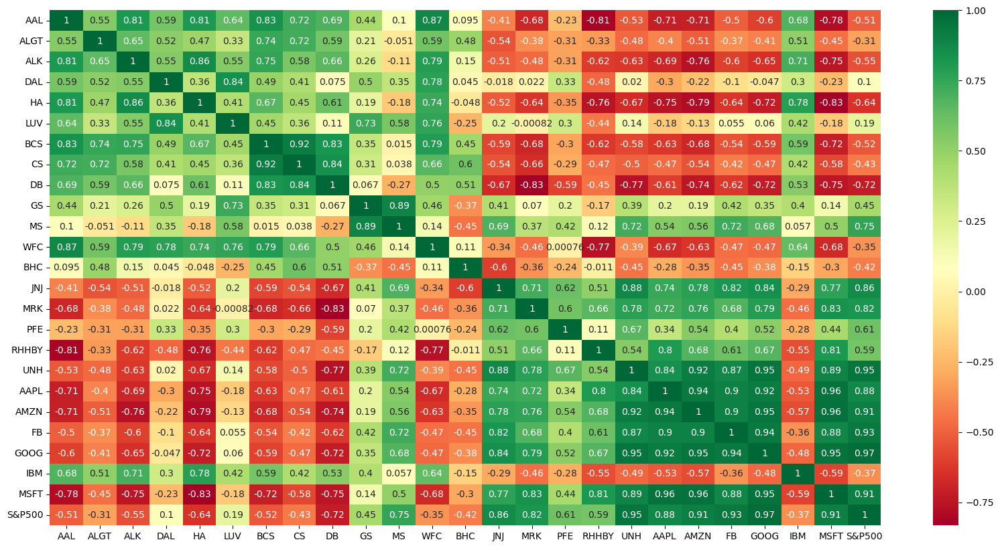

In [56]:
plt.figure(figsize = (20,10))
sns.heatmap(stocks_data.corr(),annot = True, cmap="RdYlGn")
plt.show()

#### Insights

Strong Positive Correlation (0.6 to 1) with SP500: Morgan Stanley, J&J, Merck & Co, Pfizer, UnitedHealthGroup, Apple, Amazon, Facebook, Google, Microsoft  

Weak Positive Correlation (0 to 0.6) with SP500: Delta Airlines, Southwest Airlines, Goldman Sachs, Roche Holding AG.

Negative Correlation (0 to -1) with SP500: American Airlines, Allegiant Travel Company, Alaska Air Group Inc, Hawaiian Holdings, Barclays, Credit Suisse, Deutsche Bank, Wells Fargo, Bausch Health Companies Inc, IBM.

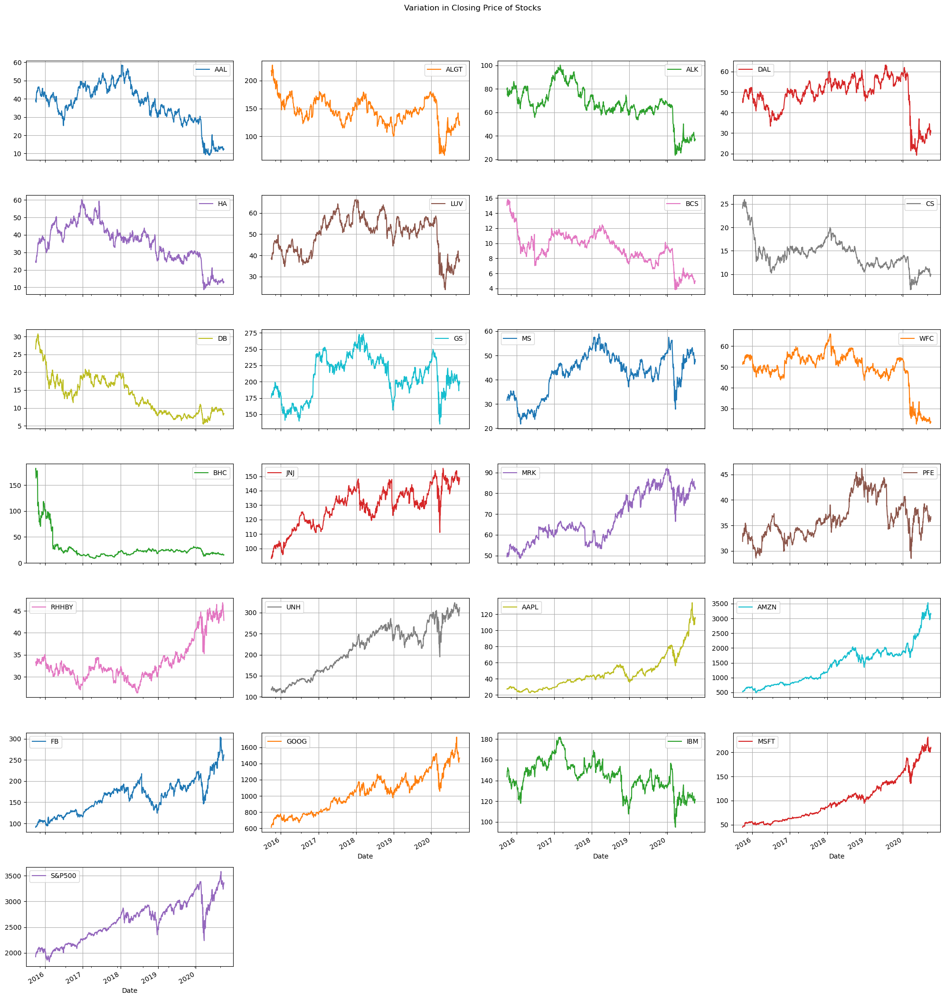

In [57]:
stocks_data.plot(kind='line', subplots=True, layout=(7, 4), figsize=(20, 20), grid=True)
plt.tight_layout()
plt.suptitle("Variation in Closing Price of Stocks", y=1.05)
plt.show()

#### Insights 

Aviation and Finance Sectors Decline: The stock prices of companies in the aviation and finance sectors, excluding Morgan Stanley, have experienced a decline.

Continued Growth in Technology and Healthcare: Technology sector stocks and several healthcare stocks have shown sustained high growth, with the exception of IBM.

Significant Price Drop: Deutsche Bank (DB) and Bausch Health Companies (BHC) have experienced the highest drop in prices.

Bausch Health Companies Inc (BHC) Decline: Bausch Health Companies Inc (BHC) initially experienced a significant decline in stock price and did not show any major trend later on.

## Normalizing the Data

In [58]:
stocks_data_norm = stocks_data.copy()

In [59]:
# defining MinMaxScaler for the normalization
scaler = MinMaxScaler()

# using fit_transform() function in MinMaxSclaer for fitting and transforming the data
scaled = scaler.fit_transform(stocks_data_norm.iloc[:])

# reassigning the normalized data to the dataframe
stocks_data_norm.iloc[:] = scaled

In [60]:
stocks_data_norm.head()

,AAL,ALGT,ALK,DAL,HA,LUV,BCS,CS,DB,GS,MS,WFC,BHC,JNJ,MRK,PFE,RHHBY,UNH,AAPL,AMZN,FB,GOOG,IBM,MSFT,S&P500
Date,,,,,,,,,,,,,,,,,,,,,,,,,
2015-10-01,0.610156,0.938873,0.739045,0.596316,0.311593,0.342763,0.933166,0.903059,0.832608,0.296583,0.263568,0.666129,0.984351,0.000000,0.017952,0.188839,0.333985,0.034410,0.043102,0.012675,0.000000,0.000000,0.559991,0.000000,0.054083
2015-10-02,0.598624,0.924086,0.726395,0.584035,0.302884,0.342056,0.964912,0.931571,0.857143,0.303735,0.261687,0.661982,1.000000,0.012191,0.035673,0.258737,0.338875,0.044761,0.044894,0.016551,0.005259,0.013984,0.571347,0.005133,0.069804
2015-10-05,0.630184,0.926994,0.747913,0.631567,0.326495,0.363743,0.982456,0.958528,0.899090,0.330395,0.284793,0.688479,0.891491,0.025505,0.060759,0.281285,0.344743,0.048585,0.045791,0.020204,0.014369,0.027019,0.622505,0.010800,0.090178
2015-10-06,0.588509,0.880839,0.664710,0.589038,0.302303,0.333098,0.978279,0.969933,0.907004,0.327650,0.286674,0.679723,0.906104,0.004010,0.027848,0.242390,0.349144,0.031799,0.046978,0.018171,0.008687,0.030573,0.619523,0.011441,0.086108
2015-10-07,0.612381,0.913259,0.683490,0.609507,0.308303,0.349835,0.993317,0.966822,0.922438,0.341449,0.301988,0.683410,0.928140,0.029034,0.054315,0.270575,0.301222,0.033571,0.045791,0.019633,0.006809,0.027816,0.634549,0.011709,0.095190


In [61]:
def plot(stocks, addAll = True):
    fig = go.Figure()

    for column in stocks.columns.to_list()[1:]:
        fig.add_trace(
            go.Scatter(
                x = stocks.index,
                y = stocks[column],
                name = column
            )
        )

    button_all = dict(label = 'All',
                      method = 'update',
                      args = [{'visible': stocks.columns[1:].isin(stocks.columns.to_list()[1:]),
                               'title': 'All',
                               'showlegend':True}])
    

    def stocks_layout_button(column):
        return dict(label = column,
                    method = 'update',
                    args = [{'visible': stocks.columns[1:].isin([column]),
                             'title': column,
                             'showlegend': True}])
    

    fig.update_layout(
        updatemenus=[go.layout.Updatemenu(
            active = 0,
            buttons = ([button_all] * addAll) + list(stocks.columns[1:].map(lambda column: stocks_layout_button(column)))
            
        )
        ])
    

    fig.update_layout(title_text="Visualizing Stock Prices Over Time",
                  xaxis_rangeslider_visible=True)
    fig.show()

In [62]:
plot(stocks_data)

#### Insights 

Amazon emerges as the best performing stock over the past five years based on the line chart analysis.

Following Amazon, Google demonstrates strong performance, positioning it as the second-best performing stock within the same timeframe.

In [63]:
def plot_normalized(stocks, addAll = True):
    fig = go.Figure()

    for column in stocks.columns.to_list()[:]:
        fig.add_trace(
            go.Scatter(
                x = stocks.index,
                y = stocks[column],
                name = column
            )
        )

    button_all = dict(label = 'All',
                      method = 'update',
                      args = [{'visible': stocks.columns[:].isin(stocks.columns.to_list()[:]),
                               'title': 'All',
                               'showlegend':True}])
    

    def stocks_layout_button(column):
        return dict(label = column,
                    method = 'update',
                    args = [{'visible': stocks.columns.isin([column]),
                             'title': column,
                             'showlegend': True}])
    

    fig.update_layout(
        updatemenus=[go.layout.Updatemenu(
            active = 0,
            buttons = ([button_all] * addAll) + list(stocks_data_norm.columns[:].map(lambda column: stocks_layout_button(column)))
            
        )
        ])
    

    fig.update_layout(title_text="Visualizing Normalized Stock Price Values",
                  xaxis_rangeslider_visible=True)
    fig.show()

In [64]:
plot_normalized(stocks_data_norm)

#### Insights 

The line chart displays how stock prices compared to the S&P500 index changed over time.

Between January 2016 and January 2020, the stock market showed strong performance overall.

However, in March 2020, there was a significant market crash caused by the pandemic, leading to a slowdown in the economy.

## Sector Wise Analysis 

### Aviation Sector

In [65]:
Aviation_stocks = stocks_data_norm[['S&P500','ALGT','AAL','ALK','DAL','HA','LUV']]

Aviation_stocks.head()

,S&P500,ALGT,AAL,ALK,DAL,HA,LUV
Date,,,,,,,
2015-10-01,0.054083,0.938873,0.610156,0.739045,0.596316,0.311593,0.342763
2015-10-02,0.069804,0.924086,0.598624,0.726395,0.584035,0.302884,0.342056
2015-10-05,0.090178,0.926994,0.630184,0.747913,0.631567,0.326495,0.363743
2015-10-06,0.086108,0.880839,0.588509,0.664710,0.589038,0.302303,0.333098
2015-10-07,0.095190,0.913259,0.612381,0.683490,0.609507,0.308303,0.349835


In [66]:
plot_normalized(Aviation_stocks)

#### Insights 

After the pandemic in March 2020, the aviation sector remained affected, failing to recover despite the S&P500 index rebounding and rising.

This lack of recovery in the aviation sector can be attributed to global travel restrictions imposed by governments worldwide.

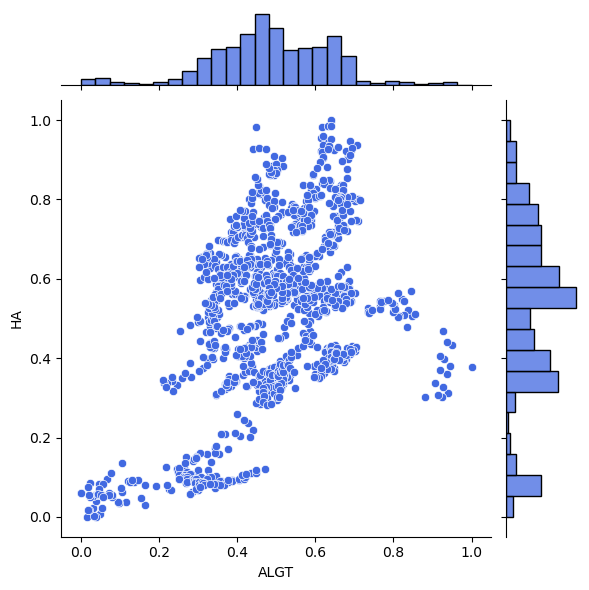

In [67]:
sns.jointplot(x='ALGT', y='HA', data=Aviation_stocks, kind='scatter', color='royalblue')
plt.show()


P value close to 1 implies a high positive correlation.
P value close to -1 implies a high negative correlation
HA and ALGT stock prices are seen to be showing lower positive correlation.

### Finance Sector 

In [68]:
Finance_Stocks=stocks_data_norm[['S&P500','BCS','CS','DB','GS','MS','WFC']]
Finance_Stocks.head()

,S&P500,BCS,CS,DB,GS,MS,WFC
Date,,,,,,,
2015-10-01,0.054083,0.933166,0.903059,0.832608,0.296583,0.263568,0.666129
2015-10-02,0.069804,0.964912,0.931571,0.857143,0.303735,0.261687,0.661982
2015-10-05,0.090178,0.982456,0.958528,0.899090,0.330395,0.284793,0.688479
2015-10-06,0.086108,0.978279,0.969933,0.907004,0.327650,0.286674,0.679723
2015-10-07,0.095190,0.993317,0.966822,0.922438,0.341449,0.301988,0.683410


In [69]:
plot_normalized(Finance_Stocks)
plt.show()

#### Insights

The finance sector experienced a significant crisis due to the Corona pandemic in March 2020, impacting most stocks.

While many stocks in the finance sector have struggled to recover, Morgan Stanley and Goldman Sachs have shown relatively strong performance compared to others.

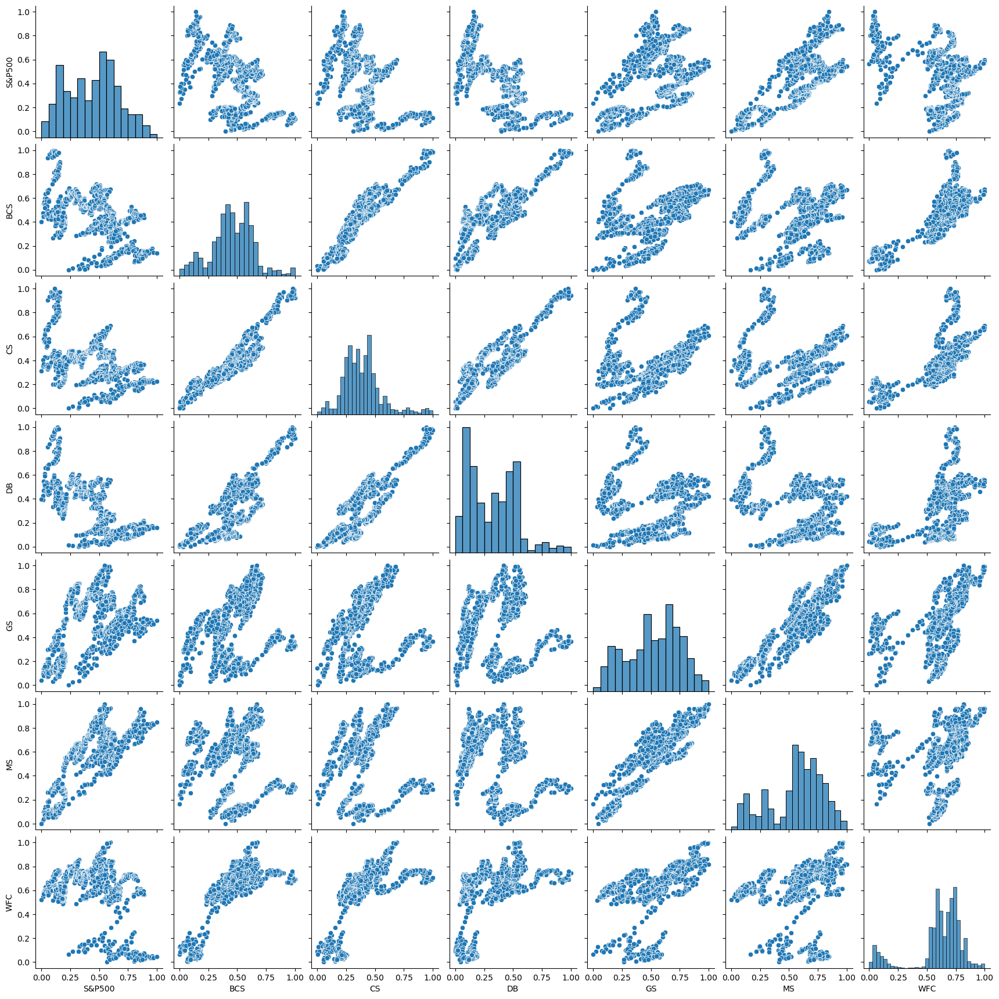

In [70]:
sns.pairplot(Finance_Stocks, kind = 'scatter')
plt.show() 

### Healthcare Pharma Sector

In [71]:
Healthcare_Stocks = stocks_data_norm[['S&P500','BHC','JNJ','MRK','PFE','RHHBY','UNH']]

In [72]:
Healthcare_Stocks.head()

,S&P500,BHC,JNJ,MRK,PFE,RHHBY,UNH
Date,,,,,,,
2015-10-01,0.054083,0.984351,0.000000,0.017952,0.188839,0.333985,0.034410
2015-10-02,0.069804,1.000000,0.012191,0.035673,0.258737,0.338875,0.044761
2015-10-05,0.090178,0.891491,0.025505,0.060759,0.281285,0.344743,0.048585
2015-10-06,0.086108,0.906104,0.004010,0.027848,0.242390,0.349144,0.031799
2015-10-07,0.095190,0.928140,0.029034,0.054315,0.270575,0.301222,0.033571


In [73]:
plot_normalized(Healthcare_Stocks)

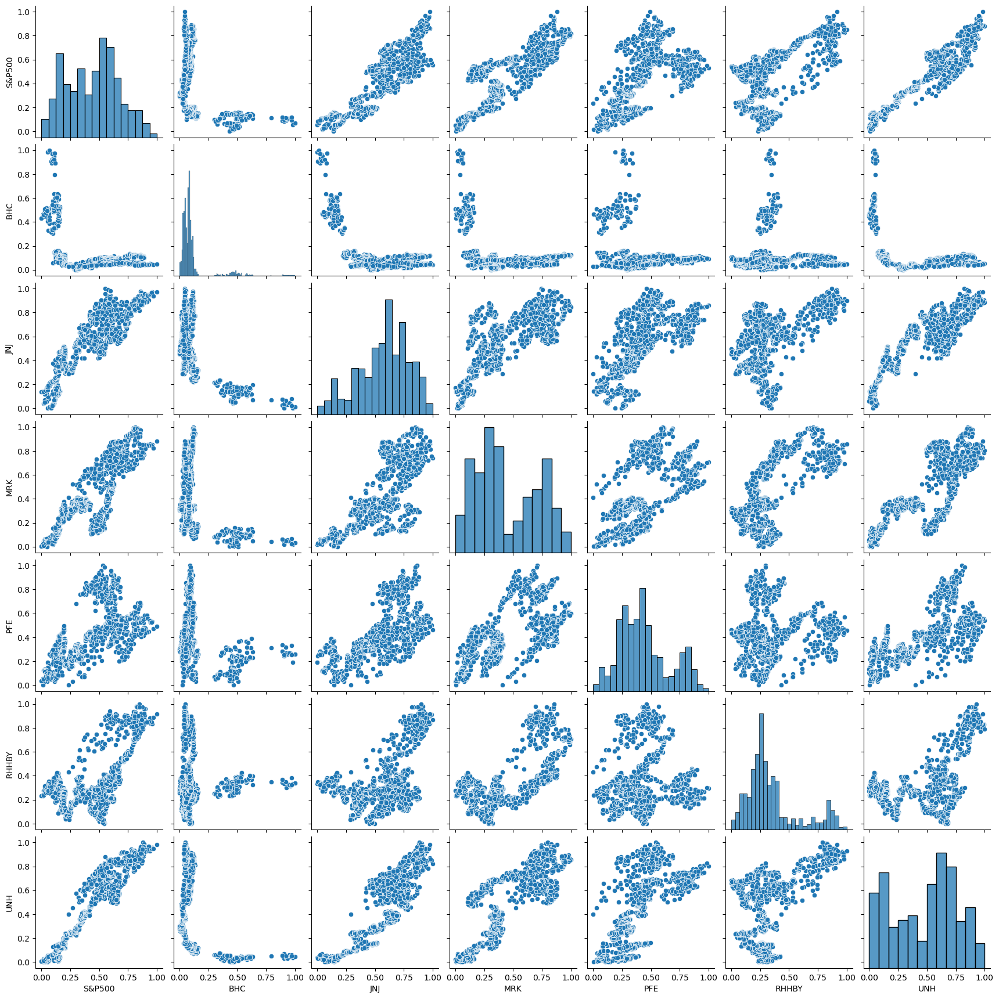

In [74]:
sns.pairplot(Healthcare_Stocks)
plt.show()

#### Insights

The pharmaceutical and healthcare sector initially faced challenges due to the pandemic but later showed notable recovery.

During this period, UnitedHealth (UNH) and Johnson & Johnson (JNJ) demonstrated strong performance compared to the S&P500 Index.

However, Bausch Health Companies (BHC) consistently underperformed compared to other stocks in the healthcare and pharmaceutical sectors over the 

### Technology Sector

In [75]:
Technology_Stocks = stocks_data_norm[['S&P500','AAPL','AMZN','FB','GOOG','IBM','MSFT']]
Technology_Stocks.head()

,S&P500,AAPL,AMZN,FB,GOOG,IBM,MSFT
Date,,,,,,,
2015-10-01,0.054083,0.043102,0.012675,0.000000,0.000000,0.559991,0.000000
2015-10-02,0.069804,0.044894,0.016551,0.005259,0.013984,0.571347,0.005133
2015-10-05,0.090178,0.045791,0.020204,0.014369,0.027019,0.622505,0.010800
2015-10-06,0.086108,0.046978,0.018171,0.008687,0.030573,0.619523,0.011441
2015-10-07,0.095190,0.045791,0.019633,0.006809,0.027816,0.634549,0.011709


In [76]:
plot_normalized(Technology_Stocks)

#### Insights 

The technology sector faced initial challenges but gradually recovered well.

During this period, Microsoft (MSFT), Amazon (AMZN), Apple (AAPL), Facebook (FB), and Google (GOOG) performed strongly, aligning with the S&P500 Market index.

However, IBM exhibited the poorest performance among technology stocks during this period, despite being the best performer before the pandemic.

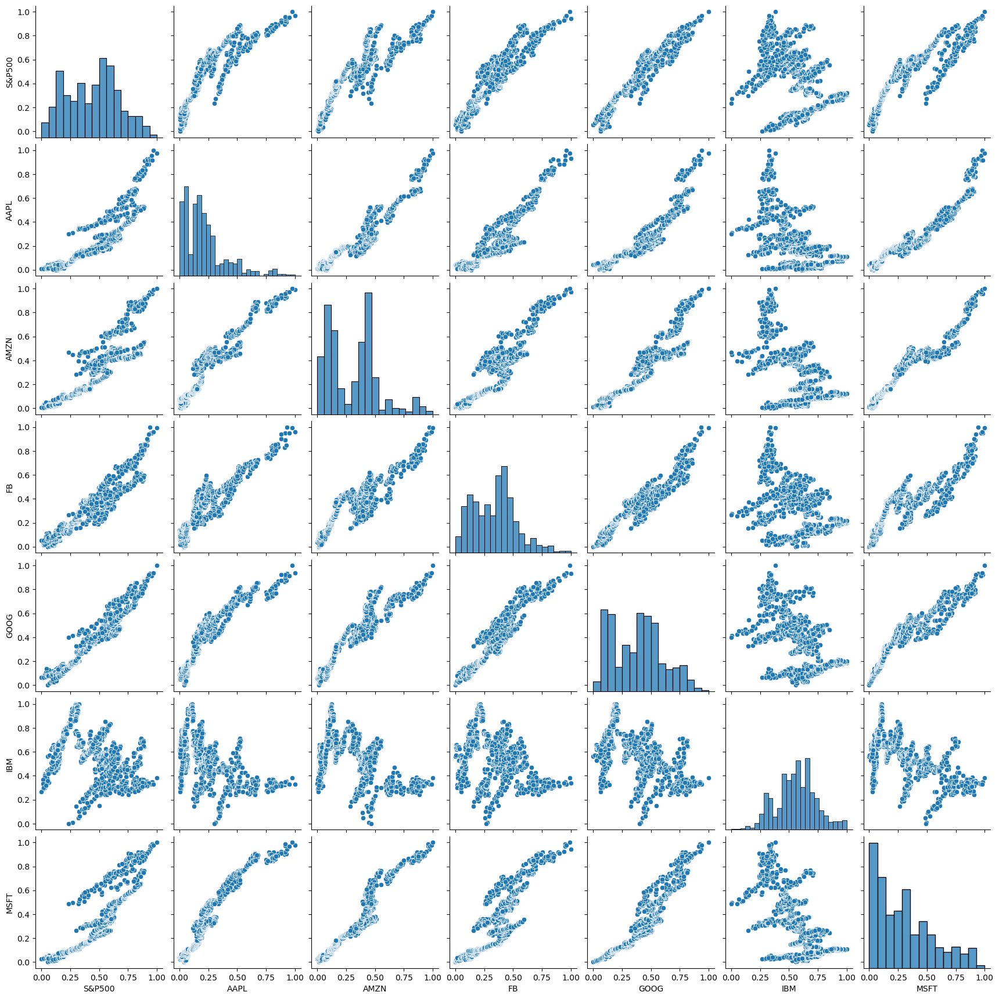

In [77]:
sns.pairplot(Technology_Stocks)
plt.show()


#### Insights

Apple and Amazon stock prices demonstrate a high positive correlation, nearing a value of 1.

Both stocks exhibit a linear increase in prices over time, indicating a consistent upward trend.

Additionally, Apple and Amazon stocks show strong correlation with the S&P500 index

### Relative Stock Price - Change in Stock Price

In [78]:
stocks_data_index = stocks_data.copy()
for column in stocks_data_index.columns:
    stocks_data_index[column] = stocks_data_index[column]/stocks_data_index['S&P500']

In [79]:
stocks_data_index.head()

,AAL,ALGT,ALK,DAL,HA,LUV,BCS,CS,DB,GS,MS,WFC,BHC,JNJ,MRK,PFE,RHHBY,UNH,AAPL,AMZN,FB,GOOG,IBM,MSFT,S&P500
Date,,,,,,,,,,,,,,,,,,,,,,,,,
2015-10-01,0.020376,0.113306,0.041703,0.023604,0.012855,0.019965,0.007802,0.012522,0.013785,0.091495,0.016374,0.026738,0.093356,0.048430,0.025662,0.016550,0.017268,0.060614,0.014240,0.270670,0.047276,0.317748,0.074638,0.023188,1.0
2015-10-02,0.019796,0.110482,0.040618,0.022994,0.012443,0.019668,0.007887,0.012627,0.013908,0.090711,0.016107,0.026269,0.093432,0.048136,0.025695,0.016952,0.017075,0.060896,0.014141,0.272907,0.047182,0.321268,0.074092,0.023353,1.0
2015-10-05,0.020226,0.108734,0.040719,0.023633,0.012833,0.019778,0.007851,0.012662,0.014192,0.090939,0.016250,0.026376,0.082263,0.047689,0.025782,0.016849,0.016829,0.060215,0.013938,0.273612,0.047311,0.322825,0.075006,0.023467,1.0
2015-10-06,0.019258,0.105358,0.037643,0.022774,0.012248,0.019193,0.007854,0.012819,0.014344,0.091074,0.016344,0.026279,0.083842,0.047184,0.025153,0.016561,0.016935,0.058613,0.014055,0.271465,0.046871,0.325993,0.075144,0.023612,1.0
2015-10-07,0.019696,0.107143,0.038064,0.023043,0.012306,0.019395,0.007881,0.012686,0.014425,0.091305,0.016499,0.026150,0.085092,0.047589,0.025528,0.016680,0.016309,0.058337,0.013876,0.271536,0.046297,0.321851,0.075202,0.023449,1.0


### Plotting the Relative Stock Price change 

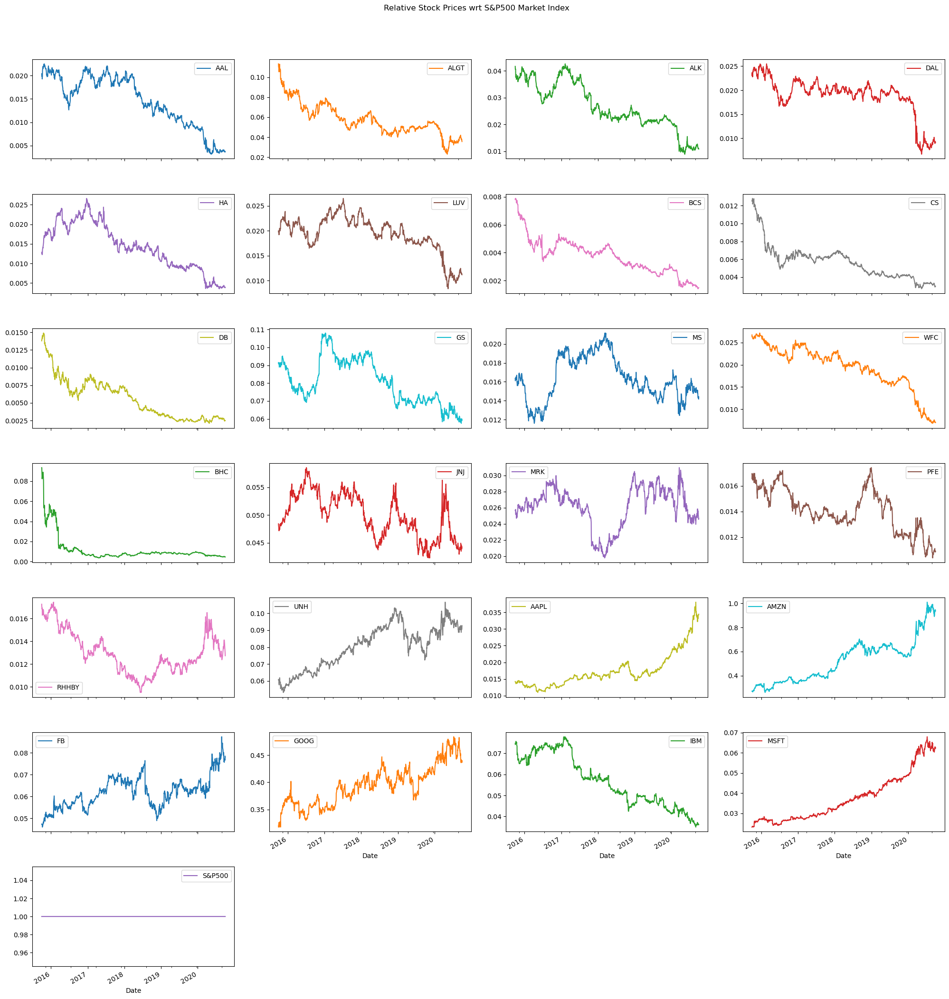

In [80]:
stocks_data_index.plot(kind = 'line',subplots=True, layout = (7,4),figsize=(20,20))
plt.tight_layout()
plt.suptitle("Relative Stock Prices wrt S&P500 Market Index",y=1.05)
plt.show()

## Daily Returns
 

Returns represent the profit or loss generated from an investment within a specific timeframe.

It's typically expressed as a percentage, representing the change in price relative to the initial price.

Returns offer more favorable statistical characteristics compared to asset prices.

To compute simple returns for each stock on a daily basis, we'll utilize the built-in function pct_change() provided by the pandas library.

In [81]:
stocks_daily_return = stocks_data.copy()

stocks_daily_return = stocks_daily_return.pct_change(1)

stocks_daily_return = round((stocks_daily_return[1:]),4)
stocks_daily_return.head()

,AAL,ALGT,ALK,DAL,HA,LUV,BCS,CS,DB,GS,MS,WFC,BHC,JNJ,MRK,PFE,RHHBY,UNH,AAPL,AMZN,FB,GOOG,IBM,MSFT,S&P500
Date,,,,,,,,,,,,,,,,,,,,,,,,,
2015-10-02,-0.0145,-0.0110,-0.0121,-0.0119,-0.0182,-0.0008,0.0253,0.0228,0.0234,0.0056,-0.0022,-0.0035,0.0151,0.0082,0.0156,0.0389,0.0030,0.0190,0.0073,0.0227,0.0123,0.0256,0.0069,0.0215,0.0143
2015-10-05,0.0404,0.0022,0.0208,0.0466,0.0502,0.0240,0.0136,0.0211,0.0391,0.0208,0.0274,0.0224,-0.1034,0.0088,0.0217,0.0121,0.0036,0.0069,0.0036,0.0209,0.0211,0.0232,0.0308,0.0233,0.0183
2015-10-06,-0.0513,-0.0345,-0.0789,-0.0398,-0.0490,-0.0331,-0.0032,0.0087,0.0071,-0.0021,0.0022,-0.0073,0.0155,-0.0141,-0.0279,-0.0206,0.0027,-0.0301,0.0048,-0.0114,-0.0129,0.0062,-0.0017,0.0026,-0.0036
2015-10-07,0.0309,0.0251,0.0193,0.0200,0.0128,0.0187,0.0116,-0.0024,0.0137,0.0106,0.0176,0.0031,0.0231,0.0167,0.0231,0.0152,-0.0292,0.0033,-0.0048,0.0083,-0.0043,-0.0048,0.0088,0.0011,0.0080
2015-10-08,0.0109,-0.0055,-0.0028,-0.0007,0.0623,0.0013,0.0051,-0.0312,-0.0139,-0.0064,0.0018,0.0067,0.0079,0.0011,0.0014,-0.0060,0.0215,-0.0030,-0.0116,-0.0162,0.0008,-0.0050,0.0146,0.0139,0.0088


In [82]:
plot(stocks_daily_return)

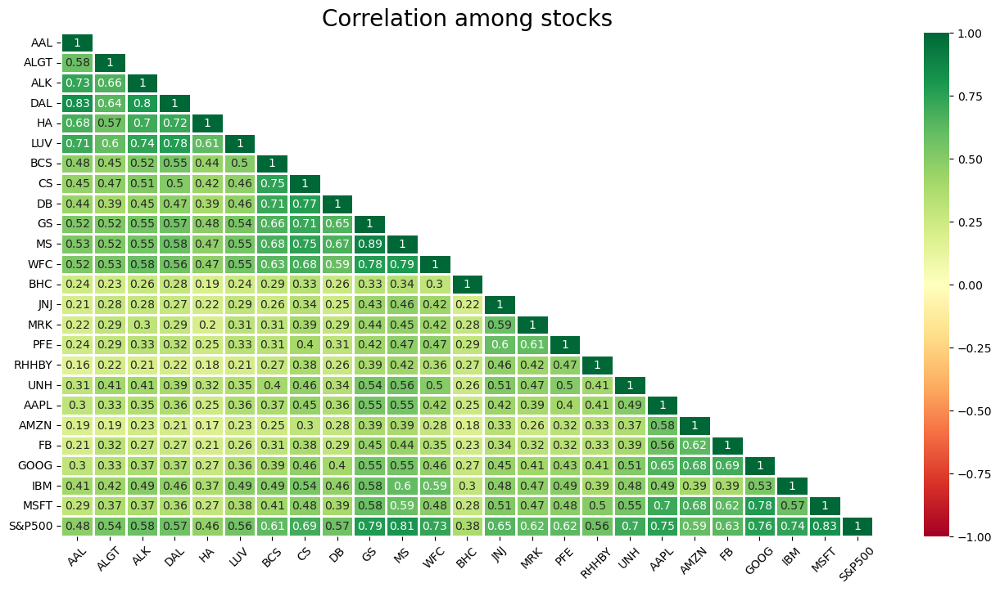

In [83]:
plt.figure(figsize=(16, 8))

# Create a mask to hide the upper triangle of the correlation matrix
mask = np.triu(np.ones_like(stocks_daily_return.corr(method='pearson')), k=1)

# Generate the heatmap with correlation values
sns.heatmap(stocks_daily_return.corr(method='pearson'), 
            cmap='RdYlGn', 
            vmax=1.0, 
            vmin=-1.0, 
            mask=mask, 
            linewidths=1.0, 
            annot=True)

# Rotate y-axis labels to be horizontal
plt.yticks(rotation=0)

# Rotate x-axis labels to be at a 45-degree angle
plt.xticks(rotation=45)

# Set the title of the heatmap
plt.title('Correlation among stocks', fontsize=20)

# Display the heatmap
plt.show()


#### Insights 

The graph reveals the following correlations in daily returns:

Microsoft and Google stocks show high correlation within the Technology sector.

Goldman Sachs, Morgan Stanley, and Wells Fargo exhibit correlation within the Finance sector.

American Airlines and Delta Airlines demonstrate stronger correlation than Alaska Air Group in the Aviation sector.

Pharma sector stocks display lower correlation compared to other sectors.

In [84]:
# function to plot the graph
def dispersion_plot(stocks, addAll = True):
    fig = go.Figure()

    for column in stocks.columns.to_list()[1:]:
        fig.add_trace(
            go.Histogram(
                x = stocks[column],
                name = column
            )
            
        )
# defining a "All" button to showcase all the stocks at a time
    button_all = dict(label = 'All',
                      method = 'update',
                      args = [{'visible': stocks.columns[1:].isin(stocks.columns.to_list()[1:]),
                               'title': 'All',
                               'showlegend':True}])
    
# defining the stocks button to showcase the individual stocks at a time
    def stocks_layout_button(column):
        return dict(label = column,
                    method = 'update',
                    args = [{'visible': stocks.columns[1:].isin([column]),
                             'title': column,
                             'showlegend': True}])
    
# after the selection of stock/slider has moved the graph has to be updated
    fig.update_layout(
        updatemenus=[go.layout.Updatemenu(
            active = 0,
            buttons = ([button_all] * addAll) + list(stocks.columns[1:].map(lambda column: stocks_layout_button(column)))
            )
        ])
    
# defining a slider option to increase or decrease the time period       
    fig.update_layout(title_text="Stock Price Dispersion from Mean",
                  xaxis_rangeslider_visible=True)
    fig.show()

In [85]:
dispersion_plot(stocks_daily_return)

The graph visually represents how far each stock is from the average.

Delta Airlines (DAL) and Deutsche Bank (DB) are notably closer to the average compared to other stocks.

## Cumulative Daily Returns 

In [86]:
stocks_cum_return = (1 + stocks_daily_return).cumprod() - 1
stocks_cum_return.head()

,AAL,ALGT,ALK,DAL,HA,LUV,BCS,CS,DB,GS,MS,WFC,BHC,JNJ,MRK,PFE,RHHBY,UNH,AAPL,AMZN,FB,GOOG,IBM,MSFT,S&P500
Date,,,,,,,,,,,,,,,,,,,,,,,,,
2015-10-02,-0.014500,-0.011000,-0.012100,-0.011900,-0.018200,-0.000800,0.025300,0.022800,0.023400,0.005600,-0.002200,-0.003500,0.015100,0.008200,0.015600,0.038900,0.003000,0.019000,0.007300,0.022700,0.012300,0.025600,0.006900,0.021500,0.014300
2015-10-05,0.025314,-0.008824,0.008448,0.034145,0.031086,0.023181,0.039244,0.044381,0.063415,0.026516,0.025140,0.018822,-0.089861,0.017072,0.037639,0.051471,0.006611,0.026031,0.010926,0.044074,0.033660,0.049394,0.037913,0.045301,0.032862
2015-10-06,-0.027284,-0.043020,-0.071118,-0.007014,-0.019437,-0.010686,0.035918,0.053467,0.070965,0.024361,0.027395,0.011384,-0.075754,0.002731,0.008688,0.029810,0.009329,-0.004852,0.015779,0.032172,0.020325,0.055900,0.036148,0.048019,0.029143
2015-10-07,0.002772,-0.019000,-0.053191,0.012846,-0.006886,0.007814,0.047935,0.050939,0.085637,0.035219,0.045477,0.014519,-0.054404,0.019477,0.031989,0.045464,-0.020144,-0.001568,0.010903,0.040739,0.015938,0.050832,0.045266,0.049172,0.037377
2015-10-08,0.013703,-0.024395,-0.055842,0.012137,0.054985,0.009124,0.053280,0.018150,0.070547,0.028594,0.047359,0.021317,-0.046934,0.020598,0.033434,0.039191,0.000923,-0.004564,-0.000823,0.023879,0.016751,0.045578,0.060527,0.063755,0.046505


We removed the first row of the Returns and Cumulative Returns columns because it contained null values, which could potentially impact our analysis. Subsequent rows were retained to accumulate return values in the dataset.

In [87]:
stocks_daily_return.dropna(axis = 0, inplace = True)
stocks_cum_return.dropna(axis = 0, inplace = True)

In [88]:
stocks_daily_return.head()

,AAL,ALGT,ALK,DAL,HA,LUV,BCS,CS,DB,GS,MS,WFC,BHC,JNJ,MRK,PFE,RHHBY,UNH,AAPL,AMZN,FB,GOOG,IBM,MSFT,S&P500
Date,,,,,,,,,,,,,,,,,,,,,,,,,
2015-10-02,-0.0145,-0.0110,-0.0121,-0.0119,-0.0182,-0.0008,0.0253,0.0228,0.0234,0.0056,-0.0022,-0.0035,0.0151,0.0082,0.0156,0.0389,0.0030,0.0190,0.0073,0.0227,0.0123,0.0256,0.0069,0.0215,0.0143
2015-10-05,0.0404,0.0022,0.0208,0.0466,0.0502,0.0240,0.0136,0.0211,0.0391,0.0208,0.0274,0.0224,-0.1034,0.0088,0.0217,0.0121,0.0036,0.0069,0.0036,0.0209,0.0211,0.0232,0.0308,0.0233,0.0183
2015-10-06,-0.0513,-0.0345,-0.0789,-0.0398,-0.0490,-0.0331,-0.0032,0.0087,0.0071,-0.0021,0.0022,-0.0073,0.0155,-0.0141,-0.0279,-0.0206,0.0027,-0.0301,0.0048,-0.0114,-0.0129,0.0062,-0.0017,0.0026,-0.0036
2015-10-07,0.0309,0.0251,0.0193,0.0200,0.0128,0.0187,0.0116,-0.0024,0.0137,0.0106,0.0176,0.0031,0.0231,0.0167,0.0231,0.0152,-0.0292,0.0033,-0.0048,0.0083,-0.0043,-0.0048,0.0088,0.0011,0.0080
2015-10-08,0.0109,-0.0055,-0.0028,-0.0007,0.0623,0.0013,0.0051,-0.0312,-0.0139,-0.0064,0.0018,0.0067,0.0079,0.0011,0.0014,-0.0060,0.0215,-0.0030,-0.0116,-0.0162,0.0008,-0.0050,0.0146,0.0139,0.0088


In [89]:
stocks_cum_return.head()

,AAL,ALGT,ALK,DAL,HA,LUV,BCS,CS,DB,GS,MS,WFC,BHC,JNJ,MRK,PFE,RHHBY,UNH,AAPL,AMZN,FB,GOOG,IBM,MSFT,S&P500
Date,,,,,,,,,,,,,,,,,,,,,,,,,
2015-10-02,-0.014500,-0.011000,-0.012100,-0.011900,-0.018200,-0.000800,0.025300,0.022800,0.023400,0.005600,-0.002200,-0.003500,0.015100,0.008200,0.015600,0.038900,0.003000,0.019000,0.007300,0.022700,0.012300,0.025600,0.006900,0.021500,0.014300
2015-10-05,0.025314,-0.008824,0.008448,0.034145,0.031086,0.023181,0.039244,0.044381,0.063415,0.026516,0.025140,0.018822,-0.089861,0.017072,0.037639,0.051471,0.006611,0.026031,0.010926,0.044074,0.033660,0.049394,0.037913,0.045301,0.032862
2015-10-06,-0.027284,-0.043020,-0.071118,-0.007014,-0.019437,-0.010686,0.035918,0.053467,0.070965,0.024361,0.027395,0.011384,-0.075754,0.002731,0.008688,0.029810,0.009329,-0.004852,0.015779,0.032172,0.020325,0.055900,0.036148,0.048019,0.029143
2015-10-07,0.002772,-0.019000,-0.053191,0.012846,-0.006886,0.007814,0.047935,0.050939,0.085637,0.035219,0.045477,0.014519,-0.054404,0.019477,0.031989,0.045464,-0.020144,-0.001568,0.010903,0.040739,0.015938,0.050832,0.045266,0.049172,0.037377
2015-10-08,0.013703,-0.024395,-0.055842,0.012137,0.054985,0.009124,0.053280,0.018150,0.070547,0.028594,0.047359,0.021317,-0.046934,0.020598,0.033434,0.039191,0.000923,-0.004564,-0.000823,0.023879,0.016751,0.045578,0.060527,0.063755,0.046505


Multiplying the last record of the DataFrame by 100 gives us the percentage change of the stock prices for the entire period.

In [90]:
#Extracting the last row and storing it in a new DataFrame.
cum_daily_return = stocks_cum_return.iloc[:, :].tail(1)

#Scaling the values by multiplying with 100 to obtain percentage change for the entire period.
cum_daily_return = cum_daily_return * 100

cum_daily_return

,AAL,ALGT,ALK,DAL,HA,LUV,BCS,CS,DB,GS,MS,WFC,BHC,JNJ,MRK,PFE,RHHBY,UNH,AAPL,AMZN,FB,GOOG,IBM,MSFT,S&P500
Date,,,,,,,,,,,,,,,,,,,,,,,,,
2020-09-30,-68.72499,-45.044019,-54.328264,-32.611233,-47.808097,-2.111784,-66.586227,-58.657195,-68.340282,14.104463,53.746587,-54.33341,-91.340709,59.757891,68.313294,14.857774,28.929886,167.149604,322.34163,504.525532,188.355431,140.66787,-15.303241,371.01307,74.774214


In [91]:
#Resetting the index to make the DataFrame consistent.
cum_daily_return = cum_daily_return.reset_index()

#Transposing the DataFrame for better visualization.
cum_daily_return = cum_daily_return.transpose()

#Excluding the date row and selecting only stock data as required.
cum_daily_return = cum_daily_return[1:]

#Renaming the column to 'Cumulative Returns'.
cum_daily_return = cum_daily_return.rename(columns={0: 'Cumulative Returns'}, inplace=False)

#Sorting the DataFrame in descending order based on cumulative returns.
cum_daily_return = cum_daily_return.sort_values('Cumulative Returns', ascending=False)

#Displaying the DataFrame 
cum_daily_return


,Cumulative Returns
AMZN,504.525532
MSFT,371.01307
AAPL,322.34163
FB,188.355431
UNH,167.149604
GOOG,140.66787
S&P500,74.774214
MRK,68.313294
JNJ,59.757891
MS,53.746587


In [92]:
# changing the datatype to float from object
cum_daily_return['Cumulative Returns'] = cum_daily_return['Cumulative Returns'].astype(float, errors = 'raise')

# round off the values by 2 decimal points 
cum_daily_return = round(cum_daily_return['Cumulative Returns'], 2)

# Displaying the dataframe
cum_daily_return

AMZN      504.53
MSFT      371.01
AAPL      322.34
FB        188.36
UNH       167.15
GOOG      140.67
S&P500     74.77
MRK        68.31
JNJ        59.76
MS         53.75
RHHBY      28.93
PFE        14.86
GS         14.10
LUV        -2.11
IBM       -15.30
DAL       -32.61
ALGT      -45.04
HA        -47.81
ALK       -54.33
WFC       -54.33
CS        -58.66
BCS       -66.59
DB        -68.34
AAL       -68.72
BHC       -91.34
Name: Cumulative Returns, dtype: float64

#### Insights

Amazon (AMZN) achieved the highest cumulative return of 504.53%, indicating strong growth.

Microsoft (MSFT) follows closely with a cumulative return of 371.01%, showcasing consistent performance.

Bausch Health Companies (BHC) recorded the lowest cumulative return of -91.34%, signifying significant decline.

## Calculation of Annualized Returns,  Annualized Risk & Sharp Ratio of the Stocks

In [93]:
stocks_daily_return.describe()

,AAL,ALGT,ALK,DAL,HA,LUV,BCS,CS,DB,GS,MS,WFC,BHC,JNJ,MRK,PFE,RHHBY,UNH,AAPL,AMZN,FB,GOOG,IBM,MSFT,S&P500
count,1258.000000,1258.000000,1258.000000,1258.000000,1258.000000,1258.000000,1258.000000,1258.000000,1258.000000,1258.000000,1258.000000,1258.000000,1258.000000,1258.000000,1258.000000,1258.000000,1258.000000,1258.000000,1258.000000,1258.000000,1258.000000,1258.000000,1258.000000,1258.000000,1258.000000
mean,-0.000338,-0.000047,-0.000255,0.000042,0.000035,0.000247,-0.000548,-0.000438,-0.000529,0.000303,0.000579,-0.000415,-0.000896,0.000450,0.000513,0.000206,0.000293,0.000941,0.001321,0.001610,0.001051,0.000835,-0.000002,0.001386,0.000517
std,0.034725,0.029100,0.026906,0.026478,0.033132,0.022912,0.025118,0.022840,0.027742,0.019899,0.021810,0.020350,0.044550,0.012459,0.014067,0.013826,0.013514,0.017810,0.018728,0.018969,0.020355,0.016521,0.016086,0.017540,0.012080
min,-0.252200,-0.283300,-0.232400,-0.259900,-0.265000,-0.151100,-0.218500,-0.182600,-0.174900,-0.127100,-0.156000,-0.158700,-0.514600,-0.100400,-0.089000,-0.077300,-0.089600,-0.172800,-0.128600,-0.079200,-0.189600,-0.111000,-0.128500,-0.147400,-0.119800
25%,-0.013600,-0.011300,-0.010700,-0.009700,-0.014900,-0.009200,-0.010800,-0.010400,-0.014975,-0.008375,-0.009000,-0.007900,-0.019675,-0.004300,-0.006200,-0.005900,-0.006275,-0.006600,-0.006200,-0.006700,-0.007200,-0.005775,-0.006500,-0.005900,-0.002900
50%,-0.000500,-0.000400,0.000250,0.000800,0.000300,0.000600,0.000000,0.000000,-0.001050,0.000300,0.000450,-0.000400,-0.000500,0.000500,0.000200,0.000100,0.000200,0.000800,0.001000,0.001600,0.001200,0.001000,0.000500,0.001200,0.000700
75%,0.013200,0.011650,0.010600,0.009775,0.015100,0.010000,0.010200,0.010400,0.013900,0.009700,0.010475,0.007575,0.018000,0.005900,0.007600,0.006375,0.006900,0.008175,0.009900,0.010775,0.010900,0.008800,0.006875,0.009200,0.005200
max,0.411000,0.292400,0.203100,0.210200,0.245800,0.144400,0.151000,0.163400,0.140200,0.175800,0.197700,0.145300,0.337400,0.080000,0.104100,0.089600,0.130100,0.128000,0.119800,0.132200,0.155200,0.104500,0.113000,0.142200,0.093800


In [94]:
# here we need only mean, standard deviation, min and max of all the stocks 
daily_return = stocks_daily_return.describe()[1:8].T.sort_values('mean', ascending = False) # sorting the values by mean

# dropping the unnecessary columns
Annual = daily_return.drop(['25%', '50%', '75%'], axis = 1)

# Renaming the columns names 
Annual = Annual.rename(columns = {'mean': 'Avg Daily Returns', 'std':'Risk', "min": "Min", "max" : "Max" }, inplace = False)

# Displaying the dataframe
Annual

,Avg Daily Returns,Risk,Min,Max
AMZN,0.001610,0.018969,-0.0792,0.1322
MSFT,0.001386,0.017540,-0.1474,0.1422
AAPL,0.001321,0.018728,-0.1286,0.1198
FB,0.001051,0.020355,-0.1896,0.1552
UNH,0.000941,0.017810,-0.1728,0.1280
GOOG,0.000835,0.016521,-0.1110,0.1045
MS,0.000579,0.021810,-0.1560,0.1977
S&P500,0.000517,0.012080,-0.1198,0.0938
MRK,0.000513,0.014067,-0.0890,0.1041
JNJ,0.000450,0.012459,-0.1004,0.0800


### Calculating Annualized_Returns 

In [95]:
Annual['Annualized_Returns']= Annual["Avg Daily Returns"]*252

In [96]:
Annual

,Avg Daily Returns,Risk,Min,Max,Annualized_Returns
AMZN,0.001610,0.018969,-0.0792,0.1322,0.405804
MSFT,0.001386,0.017540,-0.1474,0.1422,0.349334
AAPL,0.001321,0.018728,-0.1286,0.1198,0.332989
FB,0.001051,0.020355,-0.1896,0.1552,0.264800
UNH,0.000941,0.017810,-0.1728,0.1280,0.237036
GOOG,0.000835,0.016521,-0.1110,0.1045,0.210414
MS,0.000579,0.021810,-0.1560,0.1977,0.145872
S&P500,0.000517,0.012080,-0.1198,0.0938,0.130367
MRK,0.000513,0.014067,-0.0890,0.1041,0.129185
JNJ,0.000450,0.012459,-0.1004,0.0800,0.113480


#### Insights 

Amazon (AMZN) and Microsoft (MSFT) show the highest annualized returns, indicating strong potential for investment growth.

Bausch Health Companies (BHC) displays the lowest annualized return, suggesting significant decline and investment risks.

### Calculating Annualized Risk

In [97]:
Annual['Annualized_Risk']= np.sqrt(252) * Annual["Risk"]

In [98]:
Annual

,Avg Daily Returns,Risk,Min,Max,Annualized_Returns,Annualized_Risk
AMZN,0.001610,0.018969,-0.0792,0.1322,0.405804,0.301128
MSFT,0.001386,0.017540,-0.1474,0.1422,0.349334,0.278434
AAPL,0.001321,0.018728,-0.1286,0.1198,0.332989,0.297305
FB,0.001051,0.020355,-0.1896,0.1552,0.264800,0.323119
UNH,0.000941,0.017810,-0.1728,0.1280,0.237036,0.282723
GOOG,0.000835,0.016521,-0.1110,0.1045,0.210414,0.262270
MS,0.000579,0.021810,-0.1560,0.1977,0.145872,0.346225
S&P500,0.000517,0.012080,-0.1198,0.0938,0.130367,0.191764
MRK,0.000513,0.014067,-0.0890,0.1041,0.129185,0.223307
JNJ,0.000450,0.012459,-0.1004,0.0800,0.113480,0.197775


#### Insights 

Amazon (AMZN) and Microsoft (MSFT) are good choices in the tech sector. They offer nice returns with not too much risk.

Bausch Health Companies (BHC) is risky in the pharma sector. It could lose money with its high risk and negative return.

Hawaiian Holdings (HA) is the riskiest in airlines. It might have big ups and downs in returns compared to others.

### Calculating Sharpe ratio

The Sharpe ratio indicates how well an equity investment performs in comparison to the rate of return on a risk-free investment, such as U.S. government treasury bonds or bills.

In [99]:
# here we are considering the risk free rate as 0.75%
Annual['Sharpe_Ratio'] = ((Annual['Annualized_Returns'] - 0.0075)/Annual['Annualized_Risk'])/100

In [100]:
Annual

,Avg Daily Returns,Risk,Min,Max,Annualized_Returns,Annualized_Risk,Sharpe_Ratio
AMZN,0.001610,0.018969,-0.0792,0.1322,0.405804,0.301128,0.013227
MSFT,0.001386,0.017540,-0.1474,0.1422,0.349334,0.278434,0.012277
AAPL,0.001321,0.018728,-0.1286,0.1198,0.332989,0.297305,0.010948
FB,0.001051,0.020355,-0.1896,0.1552,0.264800,0.323119,0.007963
UNH,0.000941,0.017810,-0.1728,0.1280,0.237036,0.282723,0.008119
GOOG,0.000835,0.016521,-0.1110,0.1045,0.210414,0.262270,0.007737
MS,0.000579,0.021810,-0.1560,0.1977,0.145872,0.346225,0.003997
S&P500,0.000517,0.012080,-0.1198,0.0938,0.130367,0.191764,0.006407
MRK,0.000513,0.014067,-0.0890,0.1041,0.129185,0.223307,0.005449
JNJ,0.000450,0.012459,-0.1004,0.0800,0.113480,0.197775,0.005359


In [101]:
# converting values into percentages
Annual = Annual * 100

# rounding off the values by 2 decimal points 
Annual = round(Annual, 2)

Annual

,Avg Daily Returns,Risk,Min,Max,Annualized_Returns,Annualized_Risk,Sharpe_Ratio
AMZN,0.16,1.90,-7.92,13.22,40.58,30.11,1.32
MSFT,0.14,1.75,-14.74,14.22,34.93,27.84,1.23
AAPL,0.13,1.87,-12.86,11.98,33.30,29.73,1.09
FB,0.11,2.04,-18.96,15.52,26.48,32.31,0.80
UNH,0.09,1.78,-17.28,12.80,23.70,28.27,0.81
GOOG,0.08,1.65,-11.10,10.45,21.04,26.23,0.77
MS,0.06,2.18,-15.60,19.77,14.59,34.62,0.40
S&P500,0.05,1.21,-11.98,9.38,13.04,19.18,0.64
MRK,0.05,1.41,-8.90,10.41,12.92,22.33,0.54
JNJ,0.05,1.25,-10.04,8.00,11.35,19.78,0.54


In [102]:
Annual_final = pd.concat([Annual, cum_daily_return], axis=1)

Annual_final

,Avg Daily Returns,Risk,Min,Max,Annualized_Returns,Annualized_Risk,Sharpe_Ratio,Cumulative Returns
AMZN,0.16,1.90,-7.92,13.22,40.58,30.11,1.32,504.53
MSFT,0.14,1.75,-14.74,14.22,34.93,27.84,1.23,371.01
AAPL,0.13,1.87,-12.86,11.98,33.30,29.73,1.09,322.34
FB,0.11,2.04,-18.96,15.52,26.48,32.31,0.80,188.36
UNH,0.09,1.78,-17.28,12.80,23.70,28.27,0.81,167.15
GOOG,0.08,1.65,-11.10,10.45,21.04,26.23,0.77,140.67
MS,0.06,2.18,-15.60,19.77,14.59,34.62,0.40,53.75
S&P500,0.05,1.21,-11.98,9.38,13.04,19.18,0.64,74.77
MRK,0.05,1.41,-8.90,10.41,12.92,22.33,0.54,68.31
JNJ,0.05,1.25,-10.04,8.00,11.35,19.78,0.54,59.76


#### Insights 

#### The top stocks having higher returns are:

Technology : Amazon (AMZN) - 40.58% annual returns

Technology : Microsoft (MSFT) - 34.93% annual returns

Technology : Apple (AAPL) - 33.30% annual returns

Technology : Facebook (FB) - 26.48% annual returns

Healthcare : UnitedHealthCare (UNH) - 23.70% annual returns

Technology : Google (GOOG) - 21.04% annual returns

Finance : Morgan Stanley (MS) - 14.59% annual returns

S&P500 Index : 13.04% annual returns

In [103]:
Annual_final.info()

<class 'pandas.core.frame.DataFrame'>
Index: 25 entries, AMZN to BHC
Data columns (total 8 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Avg Daily Returns   25 non-null     float64
 1   Risk                25 non-null     float64
 2   Min                 25 non-null     float64
 3   Max                 25 non-null     float64
 4   Annualized_Returns  25 non-null     float64
 5   Annualized_Risk     25 non-null     float64
 6   Sharpe_Ratio        25 non-null     float64
 7   Cumulative Returns  25 non-null     float64
dtypes: float64(8)
memory usage: 1.8+ KB


###  Stock Daily Returns Over Time

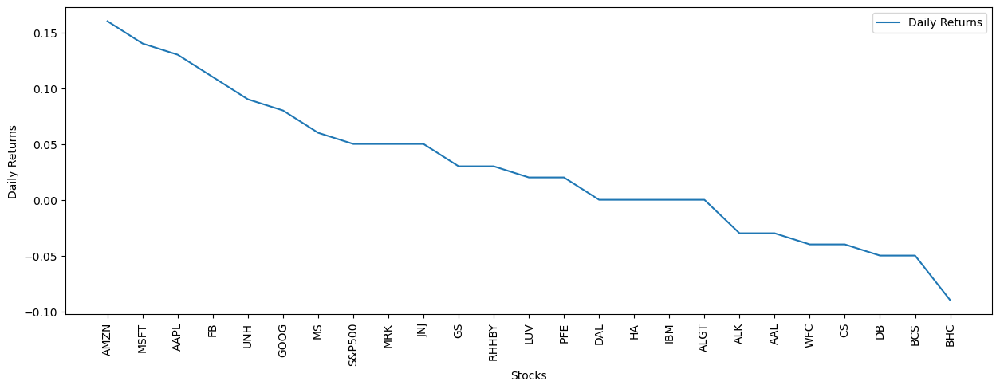

In [104]:
plt.figure(figsize=(15,5))
sns.lineplot(data=Annual_final['Avg Daily Returns'], label="Daily Returns")

# label for x-axis
plt.xlabel("Stocks")

# rotating the labels 90 degrees
plt.xticks(rotation = 90)

# Add label for y-axis
plt.ylabel("Daily Returns")

plt.show()

#### Insights 

Apple, Amazon, Facebook, Google, Microsoft, and UnitedHealthCare had higher daily returns.

Allegiant Travel Company, IBM, Hawaiian Holdings, and Delta Air Lines showed no significant returns.

Alaska Air Group, American Airlines Group, Wells Fargo, Credit Suisse, Deutsche Bank, and Bausch Health Companies experienced negative daily returns.

### Comparison of Cumulative Returns and Daily Returns of Stocks using Line Chart 

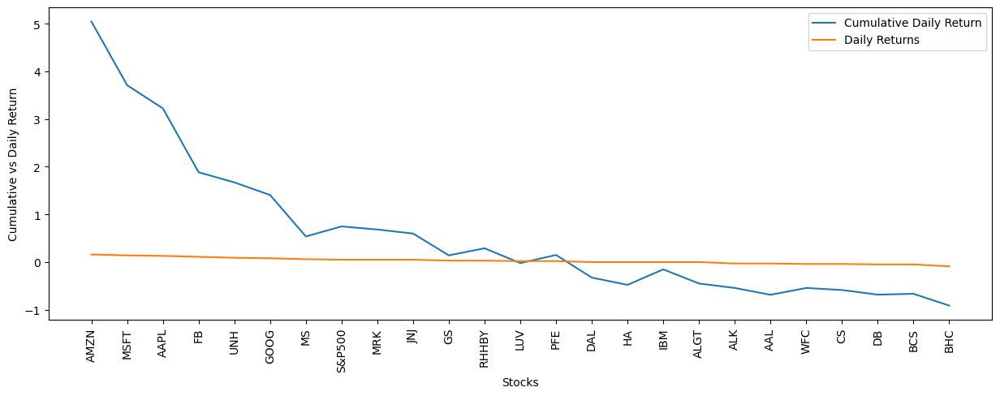

In [105]:
plt.figure(figsize=(15,5))
sns.lineplot(data=Annual_final['Cumulative Returns']/100, label="Cumulative Daily Return")
sns.lineplot(data=Annual_final['Avg Daily Returns'], label="Daily Returns")

# label for x-axis
plt.xlabel("Stocks")

# rotating the labels 90 degrees
plt.xticks(rotation = 90)

# Adding label for y-axis
plt.ylabel("Cumulative vs Daily Return")

plt.show()

The graph indicates that the chosen stocks initially faced a major decline, but later stabilized with minimal fluctuations, suggesting no significant recovery or further decline afterward.

### Comparison of Cumulative Returns and Sharpe Ratio 

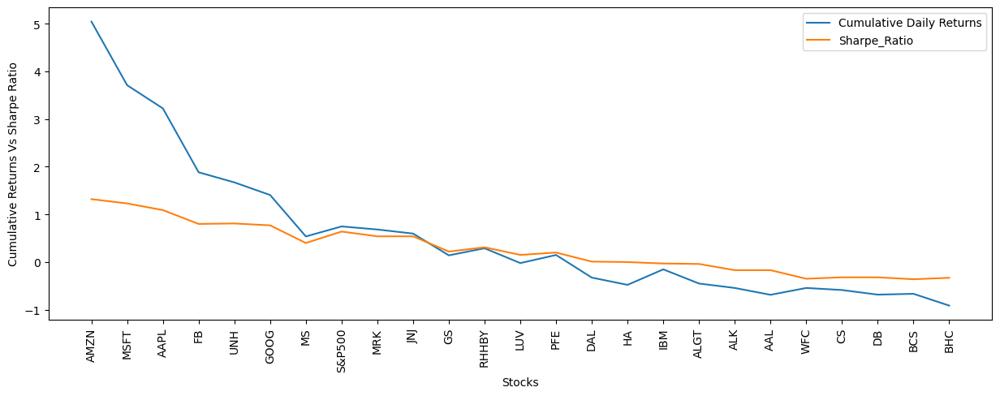

In [106]:
plt.figure(figsize=(15,5))
sns.lineplot(data=Annual_final['Cumulative Returns']/100, label="Cumulative Daily Returns")
sns.lineplot(data=Annual_final['Sharpe_Ratio'], label="Sharpe_Ratio")

# label for x-axis
plt.xlabel("Stocks")

#rotating the labels to 90 degrees
plt.xticks(rotation = 90)

# label for y-axis
plt.ylabel("Cumulative Returns Vs Sharpe Ratio")

plt.show()

The chart illustrates the cumulative daily returns and Sharpe ratio for a stock portfolio. The cumulative returns line initially drops sharply, indicating significant losses over a short period, and remains flat around a negative value, suggesting a lack of recovery. The fluctuating Sharpe ratio around 1 suggests moderate risk-adjusted performance relative to volatility, implying that the risk is moderate.

### Comparison of Cumulative Returns, Sharpe Ratio, and Risk Over Time





 

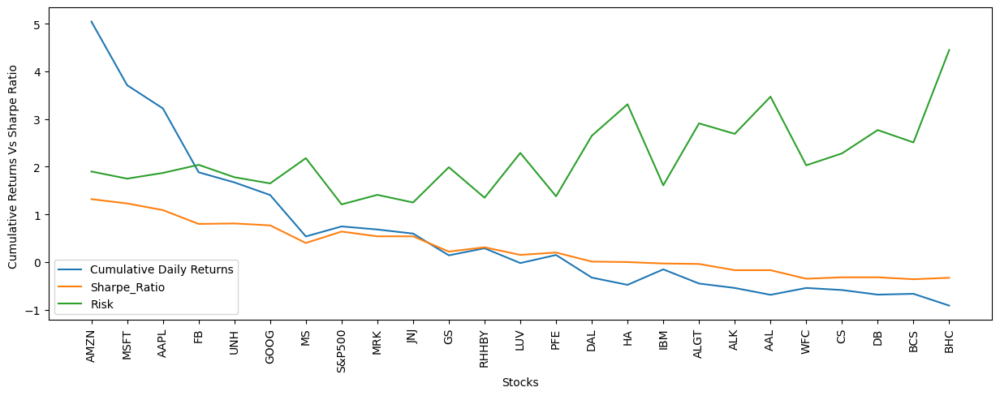

In [107]:
plt.figure(figsize=(15,5))
sns.lineplot(data=Annual_final['Cumulative Returns']/100, label="Cumulative Daily Returns")
sns.lineplot(data=Annual_final['Sharpe_Ratio'], label="Sharpe_Ratio")
sns.lineplot(data=Annual_final['Risk'], label="Risk")


# label for x-axis
plt.xlabel("Stocks")

# rotating the labels to 90 degrees
plt.xticks(rotation = 90)

# label for y-axis
plt.ylabel("Cumulative Returns Vs Sharpe Ratio ")

plt.show()

#### Insights 

Amazon (AMZN) shows the highest daily cumulative returns and Sharpe ratio, with lower risk.

Bausch Health Companies Inc. (BHC) displays the lowest cumulative daily returns and Sharpe ratio, along with the highest risk.

BHC's cumulative daily returns are negative.

# Portfolio Analysis 

## Patrick Jyengar Profile 

 Mr. Patrick Jyengar aims to double his investment within 5 years.
    
He seeks lower-risk options with reasonable returns.

Low-risk stocks like Johnson and Johnson (JNJ), Roche Holding AG (RHHBY), and Merck and Co. Inc. (MRK) are suitable for investment, considering his profile.

However, the combined returns from these stocks may not meet Mr. Patrick's investment target.

To achieve desired returns, a portion of his investment could be allocated to Microsoft (MSFT).

In [108]:
patrick_stocks = ['MSFT', 'JNJ', 'RHHBY' ,'MRK']

patrick_stock_weight = np.array([1/4, 1/4, 1/4, 1/4])

In [109]:
patrick_portfolio = stocks_data.copy()
patrick_portfolio = patrick_portfolio[patrick_stocks]

In [110]:
patrick_portfolio.head()

,MSFT,JNJ,RHHBY,MRK
Date,,,,
2015-10-01,44.610001,93.169998,33.220001,49.369999
2015-10-02,45.570000,93.930000,33.320000,50.139999
2015-10-05,46.630001,94.760002,33.439999,51.230000
2015-10-06,46.750000,93.419998,33.529999,49.799999
2015-10-07,46.799999,94.980003,32.549999,50.950001


In [111]:
patrick_portfolio.tail()

,MSFT,JNJ,RHHBY,MRK
Date,,,,
2020-09-24,203.190002,144.669998,44.700001,83.150002
2020-09-25,207.820007,145.660004,44.820000,82.930000
2020-09-28,209.440002,147.110001,44.110001,82.760002
2020-09-29,207.259995,147.059998,43.369999,81.900002
2020-09-30,210.330002,148.880005,42.810001,82.949997


### Understanding Daily Stock Returns

Daily return is the change in the price of the stock from the previous day in percentage.

In [112]:
patrick_stocks_returns = patrick_portfolio.pct_change()
patrick_stocks_returns.head(10)

,MSFT,JNJ,RHHBY,MRK
Date,,,,
2015-10-01,NaN,NaN,NaN,NaN
2015-10-02,0.021520,0.008157,0.003010,0.015597
2015-10-05,0.023261,0.008836,0.003601,0.021739
2015-10-06,0.002573,-0.014141,0.002691,-0.027913
2015-10-07,0.001069,0.016699,-0.029228,0.023092
2015-10-08,0.013889,0.001053,0.021505,0.001374
2015-10-09,-0.007165,0.003050,-0.011729,-0.001372
2015-10-12,-0.002335,0.006501,0.004260,-0.004711
2015-10-13,-0.002340,-0.005626,0.005455,-0.024453


### Average daily Return of Stock 

In [113]:
patrick_stock_return_mean = patrick_stocks_returns.mean()
print(patrick_stock_return_mean)

MSFT     0.001387
JNJ      0.000451
RHHBY    0.000293
MRK      0.000511
dtype: float64


### Risk of Stocks in Portfolio 

In [114]:
patrick_portfolio_risk = patrick_stocks_returns.std()
patrick_portfolio_risk

MSFT     0.017539
JNJ      0.012459
RHHBY    0.013514
MRK      0.014067
dtype: float64

### Daily return from the portfolio

In [115]:
patrick_stocks_returns['Portfolio Daily Returns'] = patrick_stocks_returns.dot(patrick_stock_weight)

In [116]:
patrick_stocks_returns

,MSFT,JNJ,RHHBY,MRK,Portfolio Daily Returns
Date,,,,,
2015-10-01,NaN,NaN,NaN,NaN,NaN
2015-10-02,0.021520,0.008157,0.003010,0.015597,0.012071
2015-10-05,0.023261,0.008836,0.003601,0.021739,0.014359
2015-10-06,0.002573,-0.014141,0.002691,-0.027913,-0.009197
2015-10-07,0.001069,0.016699,-0.029228,0.023092,0.002908
...,...,...,...,...,...
2020-09-24,0.012962,0.001592,-0.003567,0.006293,0.004320
2020-09-25,0.022787,0.006843,0.002685,-0.002646,0.007417
2020-09-28,0.007795,0.009955,-0.015841,-0.002050,-0.000035


### Total Portfolio Return

In [117]:
stocks_portfolio_daily_returns_patrick = (patrick_stock_weight * patrick_stock_return_mean)

stocks_portfolio_daily_returns_patrick = np.sum(stocks_portfolio_daily_returns_patrick)

stocks_portfolio_daily_returns_patrick = stocks_portfolio_daily_returns_patrick * 100
stocks_portfolio_daily_returns_patrick 

0.06603738600705662

The Daily Returns of Portfolio is around 0.066% (~0.07%) based on our stocks allocation

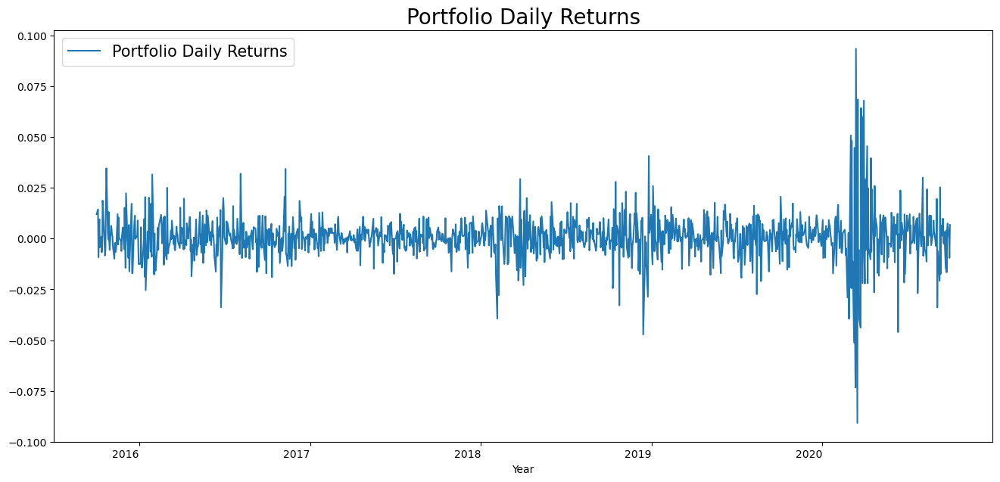

In [118]:
# Lets Plot the graph
plt.figure(figsize=(16,8))
patrick_stocks_returns['Portfolio Daily Returns'].plot()
plt.title('Portfolio Daily Returns', fontsize = 20)
plt.legend(loc = 'best', fontsize = 15)
plt.xticks(rotation=0)
plt.xlabel("Year")
plt.show()

We can see large variation in daily returns in the start of the year 2020 for the stocks in this portfolio.

This can be due to the pandemic, due to which the stock market was affected.

## Cummulative Return from the Portfolio

Cumulative return of an investment is the cumulative gain or loss from an investment over the given period of time.

In [119]:
daily_cumulative_return_patrick = (1 + patrick_stocks_returns).cumprod()

In [120]:
daily_cumulative_return_patrick.head()

,MSFT,JNJ,RHHBY,MRK,Portfolio Daily Returns
Date,,,,,
2015-10-01,NaN,NaN,NaN,NaN,NaN
2015-10-02,1.021520,1.008157,1.003010,1.015597,1.012071
2015-10-05,1.045281,1.017066,1.006622,1.037675,1.026604
2015-10-06,1.047971,1.002683,1.009332,1.008710,1.017162
2015-10-07,1.049092,1.019427,0.979831,1.032003,1.020120


## Plotting Patrick's Portfolio Daily Returns

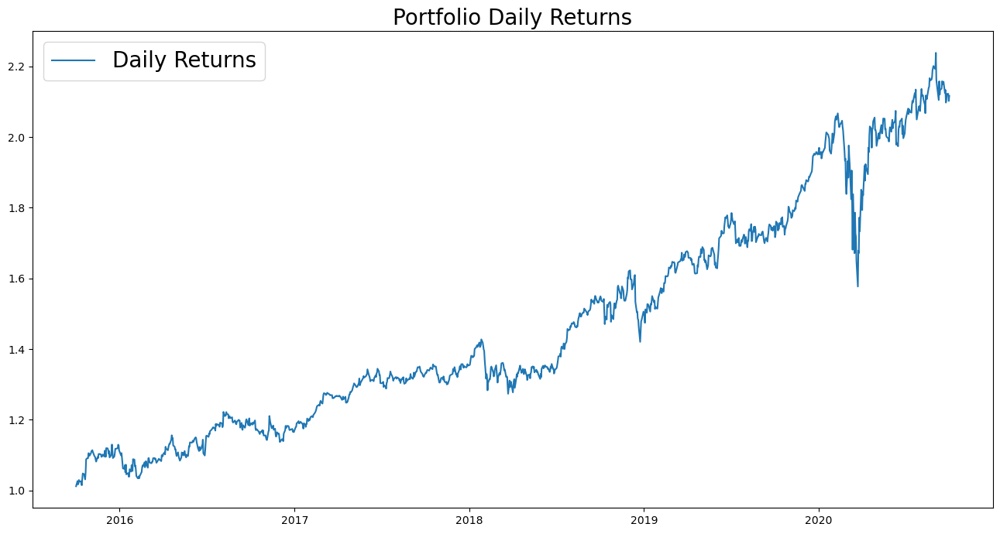

In [121]:
plt.figure(figsize=(16,8))
plt.plot(daily_cumulative_return_patrick['Portfolio Daily Returns'], label = 'Daily Returns')
plt.title('Portfolio Daily Returns', fontsize = 20)
plt.legend(loc = 'best', fontsize = 20)
plt.show()

The portfolio of the selected stocks have given good returns in the past 5 years with slow and gradual growth, which indicates stability and growth.

In the start of 2020, the stocks returns went down due to the pandemic which affected the stock market. But, it later recovered.

## Portfolio Risk – Portfolio Standard Deviation

For the portfolio risk (standard deviation) formula, we need three things:

  - Portfolio weight array.
  - Portfolio covariance matrix
  - Transpose of portfolio weight array
We will use weight for each stock in the portfolio.

In [122]:
# Covariance matrix for the portfolio

covariance_matrix_portfolio_patrick = patrick_stocks_returns.iloc[:,:-1]
covariance_matrix_portfolio_patrick = (covariance_matrix_portfolio_patrick.cov())*252

covariance_matrix_portfolio_patrick

,MSFT,JNJ,RHHBY,MRK
MSFT,0.077524,0.028277,0.029796,0.029374
JNJ,0.028277,0.039117,0.019560,0.025844
RHHBY,0.029796,0.019560,0.046023,0.020306
MRK,0.029374,0.025844,0.020306,0.049865


In [123]:
portfolio_variance_patrick = np.dot(patrick_stock_weight.T,np.dot(covariance_matrix_portfolio_patrick, patrick_stock_weight))

## Portfolio Risk (Standard deviation)

In [124]:
portfolio_risk_patrick = np.sqrt(portfolio_variance_patrick)
portfolio_risk_patrick = portfolio_risk_patrick * 100
portfolio_risk_patrick

18.00773538749593

The risk of the Portfolio is about 18.01%

## Sharpe Ratio 

In [125]:
# Assuming that the risk free rate is zero
Sharpe_Ratio_patrick = (patrick_stocks_returns['Portfolio Daily Returns'].mean() - stocks_daily_return['S&P500'].mean()) / patrick_stocks_returns['Portfolio Daily Returns'].std()
Sharpe_Ratio_patrick

0.01260994355231074

In [126]:
Annualised_Sharpe_Ratio_patrick = (252**0.5)*Sharpe_Ratio_patrick
Annualised_Sharpe_Ratio_patrick

0.20017664811585975

## Total ROI from the Portfolio

In [127]:
invested_amount_patrick = 500000

Cummulative_return_patrick = daily_cumulative_return_patrick['Portfolio Daily Returns'][-1]

Expected_Return_patrick = invested_amount_patrick * Cummulative_return_patrick

Expected_Return_patrick

1058232.526596431

In [128]:
Expected_Earning_patrick = Expected_Return_patrick - invested_amount_patrick
Expected_Earning_patrick

558232.5265964309

The Expected Returns are 1.05 Million Dollars on an investment of 500 Thousand Dollars with a 558 Thousand Dollars Profit.

## Overall Portfolio Information

In [129]:
portfolio_patrick_stock_info = Annual.filter(items=patrick_stocks, axis=0)
portfolio_patrick_stock_info

,Avg Daily Returns,Risk,Min,Max,Annualized_Returns,Annualized_Risk,Sharpe_Ratio
MSFT,0.14,1.75,-14.74,14.22,34.93,27.84,1.23
JNJ,0.05,1.25,-10.04,8.00,11.35,19.78,0.54
RHHBY,0.03,1.35,-8.96,13.01,7.39,21.45,0.31
MRK,0.05,1.41,-8.90,10.41,12.92,22.33,0.54


In [130]:
data_patrick_portfolio = {
                          'Portfolio Returns (%)'             : [stocks_portfolio_daily_returns_patrick], 
                          'Portfolio Risk (%)'                : [portfolio_risk_patrick],
                          'Portfolio Sharpe Ratio'            : [Sharpe_Ratio_patrick],
                          'Portfolio Annual Sharpe Ratio'     : [Annualised_Sharpe_Ratio_patrick],
                          'Invested Amount'                   : [invested_amount_patrick],
                          'Expected Earnings'                 : [Expected_Earning_patrick],
                          'Expected Returns'                  : [Expected_Return_patrick]
                        }


portfolio_patrick_info = pd.DataFrame(data=data_patrick_portfolio, columns=[
                                                                       'Portfolio Returns (%)', 
                                                                       'Portfolio Risk (%)', 
                                                                       'Portfolio Sharpe Ratio', 
                                                                       'Portfolio Annual Sharpe Ratio', 
                                                                       'Invested Amount', 
                                                                       'Expected Earnings',
                                                                       'Expected Returns'
                                                                       ], 
                                    index=['Mr. Patrick Portfolio'])


portfolio_patrick_info[['Portfolio Returns (%)', 'Portfolio Risk (%)', 
                    'Expected Earnings', 'Expected Returns']] = portfolio_patrick_info[['Portfolio Returns (%)', 
                                                                                        'Portfolio Risk (%)', 
                                                                                        'Expected Earnings', 
                                                                                        'Expected Returns']].round(decimals=2)

In [131]:
portfolio_patrick_info

,Portfolio Returns (%),Portfolio Risk (%),Portfolio Sharpe Ratio,Portfolio Annual Sharpe Ratio,Invested Amount,Expected Earnings,Expected Returns
Mr. Patrick Portfolio,0.07,18.01,0.01261,0.200177,500000,558232.53,1058232.53


If Mr. Patrick Jyengar invests 500,000 Dollars in the above Portfolio, the returns that he can expect after 5 years is 1.05 Million Dollar with 558.23 Thousand dollar of gain on investment.

# Peter Jyengar Portfolio

Mr. Peter Jyengar wants to take risks and he prefers high-return on his investments.

He believes that he can still bounce back in case of any occasional losses.

He wants to invest the whole amount, which is 1 million dollars in stocks having highest margins and is expecting high returns on his investment within 5 years which will be further used for inorganic expansion of JWW.

High risk and High Returns stocks like Amazon (AMZN), Microsoft (MSFT), Apple (AAPL) are suitable for his profile.

These stocks would help him get higher return on his investment

In [132]:
stocks_peter = ['AMZN','MSFT', 'AAPL']

stocks_weight_peter = np.array([1/3,1/3,1/3])

We are equally distributing the 1 million dollars of Mr. Peter Jyenger among these 6 stocks.

In [133]:
portfolio_peter = stocks_data.copy()
portfolio_peter = portfolio_peter[stocks_peter]

In [134]:
portfolio_peter.head()

,AMZN,MSFT,AAPL
Date,,,
2015-10-01,520.719971,44.610001,27.395000
2015-10-02,532.539978,45.570000,27.594999
2015-10-05,543.679993,46.630001,27.695000
2015-10-06,537.479980,46.750000,27.827499
2015-10-07,541.940002,46.799999,27.695000


## Daily return from Stocks

Daily return is the change in the price of the stock from the previous day in percentage.

In [135]:
stocks_returns_peter = portfolio_peter.pct_change()

stocks_returns_peter.head(10)

,AMZN,MSFT,AAPL
Date,,,
2015-10-01,NaN,NaN,NaN
2015-10-02,0.022699,0.021520,0.007301
2015-10-05,0.020919,0.023261,0.003624
2015-10-06,-0.011404,0.002573,0.004784
2015-10-07,0.008298,0.001069,-0.004761
2015-10-08,-0.016201,0.013889,-0.011554
2015-10-09,0.012454,-0.007165,0.023927
2015-10-12,0.019248,-0.002335,-0.004638
2015-10-13,-0.002345,-0.002340,0.001703


## Average Daily return from the Stocks

In [136]:
mean_stocks_daily_return_peter = stocks_returns_peter.mean()
print(mean_stocks_daily_return_peter)

AMZN    0.001611
MSFT    0.001387
AAPL    0.001322
dtype: float64


## Risk of Stocks in portfolio

In [137]:
stock_risk_peter = stocks_returns_peter.std()
stock_risk_peter

AMZN    0.018969
MSFT    0.017539
AAPL    0.018729
dtype: float64

## Daily Return from the portfolio

The weighted average can be calculated to determine the return from the portfolio on a daily basis

In [138]:
# Daily Return from the portfolio
stocks_returns_peter['Portfolio Daily Returns'] = stocks_returns_peter.dot(stocks_weight_peter)
stocks_returns_peter

,AMZN,MSFT,AAPL,Portfolio Daily Returns
Date,,,,
2015-10-01,NaN,NaN,NaN,NaN
2015-10-02,0.022699,0.021520,0.007301,0.017173
2015-10-05,0.020919,0.023261,0.003624,0.015934
2015-10-06,-0.011404,0.002573,0.004784,-0.001349
2015-10-07,0.008298,0.001069,-0.004761,0.001535
...,...,...,...,...
2020-09-24,0.006644,0.012962,0.010269,0.009958
2020-09-25,0.024949,0.022787,0.037516,0.028417
2020-09-28,0.025498,0.007795,0.023869,0.019054


## Total Portfolio Return

In [139]:
stocks_portfolio_daily_returns_peter = (stocks_weight_peter * mean_stocks_daily_return_peter)

portfolio_return_peter = np.sum(stocks_portfolio_daily_returns_peter)
# Converting into percentage
portfolio_return_peter = portfolio_return_peter * 100
portfolio_return_peter

0.14399092961535384

The Total Daily Portfolio Returns of the stock allocation is around 0.14%

## Plotting Daily Returns for Stocks from Peter's Portfolio

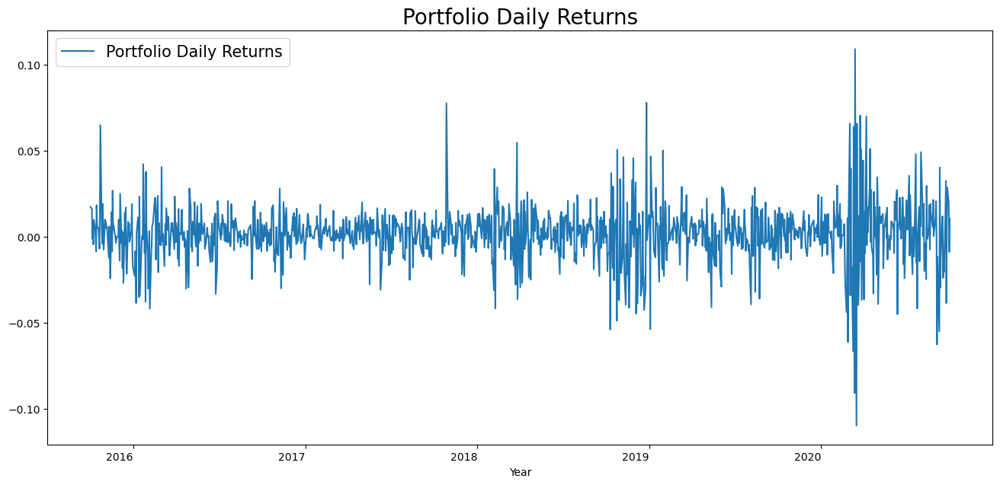

In [140]:
# Lets Plot the graph
plt.figure(figsize=(16,8))
stocks_returns_peter['Portfolio Daily Returns'].plot()
plt.title('Portfolio Daily Returns', fontsize = 20)
plt.legend(loc = 'best', fontsize = 15)
plt.xticks(rotation=0)
plt.xlabel("Year")
plt.show()

We can see that there are frequent huge variations in daily returns from end of 2017 to 2020.

The variations were highest in the start of 2020 because of pandemic that affected the stock market.

## Cummulative Return from the Portfolio

Cumulative return of an investment is the cumulative gain or loss from an investment over the given period of time.

In [141]:
daily_cumulative_return_peter = (1+ stocks_returns_peter).cumprod()

daily_cumulative_return_peter.tail(10)

,AMZN,MSFT,AAPL,Portfolio Daily Returns
Date,,,,
2020-09-17,5.778019,4.548532,4.027742,4.968769
2020-09-18,5.674662,4.492042,3.899982,4.866035
2020-09-21,5.685340,4.540237,4.018252,4.935679
2020-09-22,6.008969,4.649630,4.081402,5.094827
2020-09-23,5.760985,4.496525,3.910203,4.897583
2020-09-24,5.799259,4.554808,3.950356,4.946354
2020-09-25,5.943943,4.658597,4.098558,5.086915
2020-09-28,6.095503,4.694911,4.196386,5.183842
2020-09-29,6.039484,4.646043,4.164628,5.136899


## Plotting Daily Returns

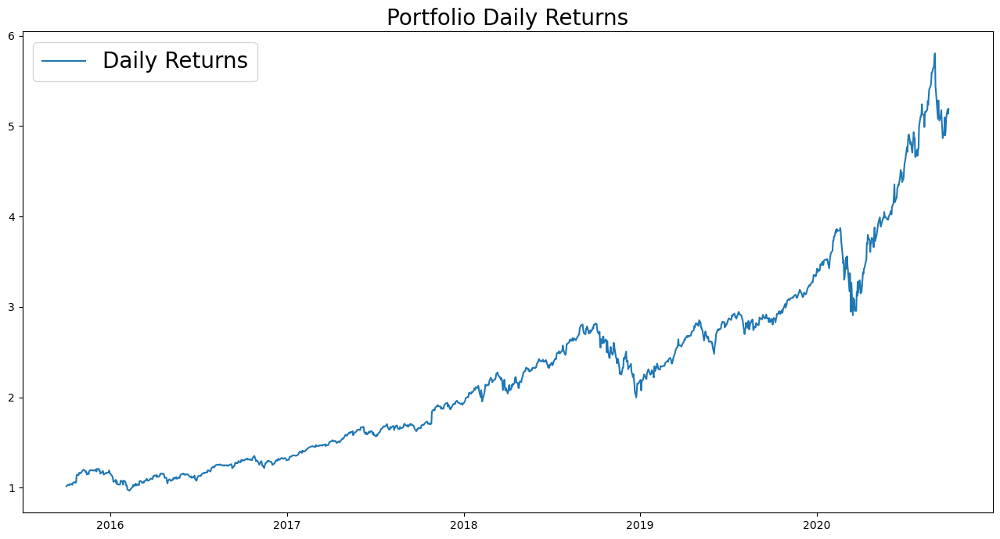

In [142]:
plt.figure(figsize=(16,8))
plt.plot(daily_cumulative_return_peter['Portfolio Daily Returns'], label = 'Daily Returns')
plt.title('Portfolio Daily Returns', fontsize = 20)
plt.legend(loc = 'best', fontsize = 20)
plt.show()

The portfolio of the selected stocks have given high returns in the past 5 years with significant growth.

During the end of 2018, the stocks went down and recovered in the start of 2019.

In the start of 2020, the stocks returns went down due to the pandemic which affected the stock market. But, it later recovered and grew significantly.

## Portfolio Risk – Portfolio Standard Deviation

For the portfolio standard deviation formula, we need three elements:

  - Portfolio weight array.
  - Portfolio covariance matrix.
  - Transpose of portfolio weight array.

In [143]:
# Covariance matrix for the portfolio
covariance_matrix_portfolio_peter = stocks_returns_peter.iloc[:,:-1]
covariance_matrix_portfolio_peter = (covariance_matrix_portfolio_peter.cov())*252

covariance_matrix_portfolio_peter

,AMZN,MSFT,AAPL
AMZN,0.090671,0.056626,0.051597
MSFT,0.056626,0.077524,0.058350
AAPL,0.051597,0.058350,0.088398


In [144]:
portfolio_variance_peter = np.dot(stocks_weight_peter.T,np.dot(covariance_matrix_portfolio_peter, stocks_weight_peter))

In [145]:
# Standard deviation (risk of portfolio)
portfolio_risk_peter = np.sqrt(portfolio_variance_peter)
# Converting into percentage
portfolio_risk_peter = portfolio_risk_peter * 100
portfolio_risk_peter

25.598152392922675

The Portfolio risk is 25.6%.

## Sharpe Ratio

In [146]:
Sharpe_Ratio_peter = (stocks_returns_peter['Portfolio Daily Returns'].mean() - stocks_daily_return['S&P500'].mean()) / stocks_returns_peter['Portfolio Daily Returns'].std()
Sharpe_Ratio_peter

0.05721313966272372

In [147]:
Annualized_Sharpe_Ratio_Peter = (252**0.5)*Sharpe_Ratio_peter
Annualized_Sharpe_Ratio_Peter

0.9082304356366369

## Total ROI from the Portfolio

In [148]:
invested_amount_peter = 1000000

Cummulative_return_peter = daily_cumulative_return_peter['Portfolio Daily Returns'][-1]

Expected_Return_peter = invested_amount_peter * Cummulative_return_peter

Expected_Return_peter

5190172.649921075

In [149]:
Expected_Earning_peter = Expected_Return_peter - invested_amount_peter
Expected_Earning_peter

4190172.6499210754

The Expected Returns are 5.1 Million Dollars on an investment of 1 Million Dollars with a 4.1 Million Dollars Profit

## Overall Portfolio Information

In [150]:
portfolio_peter_stock_info = Annual.filter(items=stocks_peter, axis=0)
portfolio_peter_stock_info

,Avg Daily Returns,Risk,Min,Max,Annualized_Returns,Annualized_Risk,Sharpe_Ratio
AMZN,0.16,1.90,-7.92,13.22,40.58,30.11,1.32
MSFT,0.14,1.75,-14.74,14.22,34.93,27.84,1.23
AAPL,0.13,1.87,-12.86,11.98,33.30,29.73,1.09


In [151]:
data_peter_portfolio = {
                          'Portfolio Returns (%)'             : [portfolio_return_peter], 
                          'Portfolio Risk (%)'                : [portfolio_risk_peter],
                          'Portfolio Sharpe Ratio'            : [Sharpe_Ratio_peter],
                          'Portfolio Annual Sharpe Ratio'     : [Annualized_Sharpe_Ratio_Peter],
                          'Invested Amount'                   : [invested_amount_peter],
                          'Expected Earnings'                 : [Expected_Earning_peter],
                          'Expected Returns'                  : [Expected_Return_peter]
                        }


portfolio_peter_info = pd.DataFrame(data=data_peter_portfolio, columns=[
                                                                       'Portfolio Returns (%)', 
                                                                       'Portfolio Risk (%)', 
                                                                       'Portfolio Sharpe Ratio', 
                                                                       'Portfolio Annual Sharpe Ratio', 
                                                                       'Invested Amount', 
                                                                       'Expected Earnings',
                                                                       'Expected Returns'
                                                                       ], 
                                    index=['Mr. Peter Portfolio'])


portfolio_peter_info[['Portfolio Returns (%)', 'Portfolio Risk (%)', 
                      'Expected Earnings', 'Expected Returns']] = portfolio_peter_info[['Portfolio Returns (%)', 
                                                                                        'Portfolio Risk (%)', 
                                                                                        'Expected Earnings', 
                                                                                        'Expected Returns']].round(decimals=2)

In [152]:
portfolio_peter_info

,Portfolio Returns (%),Portfolio Risk (%),Portfolio Sharpe Ratio,Portfolio Annual Sharpe Ratio,Invested Amount,Expected Earnings,Expected Returns
Mr. Peter Portfolio,0.14,25.6,0.057213,0.90823,1000000,4190172.65,5190172.65


If Mr. Peter Jyengar invests 1 Million Dollars in the above Portfolio, the returns that he can expect after 5 years is around 5.1 Million Dollars with more than 4 Million dollars of gain on investment.